In [1]:
import sys
!{sys.executable} -m pip -q install palantir fa2


[notice] A new release of pip available: 22.3.1 -> 23.1
[notice] To update, run: pip install --upgrade pip


In [2]:
import warnings
warnings.filterwarnings("ignore")
from anndata import AnnData
import numpy as np
import pandas as pd
import scanpy as sc
import scFates as scf
import palantir
import matplotlib.pyplot as plt
sc.settings.verbosity = 3
sc.settings.logfile = sys.stdout
## fix palantir breaking down some plots
import seaborn
seaborn.reset_orig()
%matplotlib inline

sc.set_figure_params()
scf.set_figure_pubready()

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.


In [4]:
intact = sc.read_h5ad('/mnt/c/Users/Emil/10X/axolotl_intact.h5ad')

In [5]:
contra = sc.read_h5ad('/mnt/c/Users/Emil/10X/axolotl_contra.h5ad')

In [6]:
intact.obs

,seq_folder,nUMI,nGene,percent.mt,log10GenesPerUMI,cells,sample,RNA_snn_res.0.8,seurat_clusters,RNA_snn_res.0.4,nCount_RNA,nFeature_RNA,RNA_snn_res.0.6,RNA_snn_res.0.1,RNA_snn_res.1
Intact_4N_1_S1_AAACCCAGTAAGTTAG-1,Intact_4N_1_S1,14646.0,912,0.000000,0.710560,Intact_4N_1_S1_AAACCCAGTAAGTTAG-1,intact,13,11,9,14646.0,912,11,3,11
Intact_4N_1_S1_AAACCCAGTACCCGCA-1,Intact_4N_1_S1,3705.0,1451,0.000000,0.885922,Intact_4N_1_S1_AAACCCAGTACCCGCA-1,intact,9,8,6,3705.0,1451,8,1,21
Intact_4N_1_S1_AAACCCATCTTAAGGC-1,Intact_4N_1_S1,11023.0,5216,0.000000,0.919610,Intact_4N_1_S1_AAACCCATCTTAAGGC-1,intact,5,5,2,11023.0,5216,5,1,4
Intact_4N_1_S1_AAACGAAAGACATAGT-1,Intact_4N_1_S1,21566.0,6102,0.000000,0.873483,Intact_4N_1_S1_AAACGAAAGACATAGT-1,intact,1,2,0,21566.0,6102,2,0,1
Intact_4N_1_S1_AAACGAACACTGTGAT-1,Intact_4N_1_S1,46071.0,4446,0.000000,0.782251,Intact_4N_1_S1_AAACGAACACTGTGAT-1,intact,11,11,9,46071.0,4446,11,3,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Intact_4N_5_S4_TTTGGAGTCAAACCTG-1,Intact_4N_5_S4,2730.0,1768,0.000000,0.945090,Intact_4N_5_S4_TTTGGAGTCAAACCTG-1,intact,4,5,4,2730.0,1768,5,1,3
Intact_4N_5_S4_TTTGGAGTCTTCTGTA-1,Intact_4N_5_S4,6099.0,2393,0.000000,0.892658,Intact_4N_5_S4_TTTGGAGTCTTCTGTA-1,intact,9,8,6,6099.0,2393,8,1,19
Intact_4N_5_S4_TTTGGTTAGCGATGAC-1,Intact_4N_5_S4,6149.0,3179,0.000000,0.924379,Intact_4N_5_S4_TTTGGTTAGCGATGAC-1,intact,6,1,1,6149.0,3179,1,0,0
Intact_4N_5_S4_TTTGTTGGTCTACGAT-1,Intact_4N_5_S4,30363.0,8697,0.003293,0.878864,Intact_4N_5_S4_TTTGTTGGTCTACGAT-1,intact,4,5,4,30363.0,8697,5,1,3


In [13]:
intact_metadata = pd.read_csv(r"//mnt//c//Users//Emil//10X//axolotl_intact_metadata.csv")

In [14]:
contra_metadata = pd.read_csv(r"//mnt//c//Users//Emil//10X//axolotl_contra_metadata.csv")

In [15]:
contra_metadata = contra_metadata.rename(columns = {'Unnamed: 0':'CellID'})
intact_metadata = intact_metadata.rename(columns = {'Unnamed: 0':'CellID'})

In [16]:
contra_metadata = contra_metadata.set_index('CellID')
intact_metadata = intact_metadata.set_index('CellID')

In [17]:
intact_metadata

,seq_folder,nUMI,nGene,percent.mt,log10GenesPerUMI,cells,sample,RNA_snn_res.0.8,seurat_clusters,RNA_snn_res.0.4,nCount_RNA,nFeature_RNA,RNA_snn_res.0.6,RNA_snn_res.0.1,RNA_snn_res.1,labels
CellID,,,,,,,,,,,,,,,,
Intact_4N_1_S1_AAACCCAGTAAGTTAG-1,Intact_4N_1_S1,14646,912,0.000000,0.710560,Intact_4N_1_S1_AAACCCAGTAAGTTAG-1,intact,13,11,9,14646,912,11,3,11,RBC I
Intact_4N_1_S1_AAACCCAGTACCCGCA-1,Intact_4N_1_S1,3705,1451,0.000000,0.885922,Intact_4N_1_S1_AAACCCAGTACCCGCA-1,intact,9,8,6,3705,1451,8,1,21,Epidermal IV
Intact_4N_1_S1_AAACCCATCTTAAGGC-1,Intact_4N_1_S1,11023,5216,0.000000,0.919610,Intact_4N_1_S1_AAACCCATCTTAAGGC-1,intact,5,5,2,11023,5216,5,1,4,Epidermal II
Intact_4N_1_S1_AAACGAAAGACATAGT-1,Intact_4N_1_S1,21566,6102,0.000000,0.873483,Intact_4N_1_S1_AAACGAAAGACATAGT-1,intact,1,2,0,21566,6102,2,0,1,Fibroblast III
Intact_4N_1_S1_AAACGAACACTGTGAT-1,Intact_4N_1_S1,46071,4446,0.000000,0.782251,Intact_4N_1_S1_AAACGAACACTGTGAT-1,intact,11,11,9,46071,4446,11,3,16,RBC I
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Intact_4N_5_S4_TTTGGAGTCAAACCTG-1,Intact_4N_5_S4,2730,1768,0.000000,0.945090,Intact_4N_5_S4_TTTGGAGTCAAACCTG-1,intact,4,5,4,2730,1768,5,1,3,Epidermal II
Intact_4N_5_S4_TTTGGAGTCTTCTGTA-1,Intact_4N_5_S4,6099,2393,0.000000,0.892658,Intact_4N_5_S4_TTTGGAGTCTTCTGTA-1,intact,9,8,6,6099,2393,8,1,19,Epidermal IV
Intact_4N_5_S4_TTTGGTTAGCGATGAC-1,Intact_4N_5_S4,6149,3179,0.000000,0.924379,Intact_4N_5_S4_TTTGGTTAGCGATGAC-1,intact,6,1,1,6149,3179,1,0,0,Fibroblast II


In [18]:
intact.obs['labels1'] = intact_metadata['labels']
contra.obs['labels1'] = contra_metadata['labels']

In [19]:
intact.obs

,seq_folder,nUMI,nGene,percent.mt,log10GenesPerUMI,cells,sample,RNA_snn_res.0.8,seurat_clusters,RNA_snn_res.0.4,nCount_RNA,nFeature_RNA,RNA_snn_res.0.6,RNA_snn_res.0.1,RNA_snn_res.1,labels1
Intact_4N_1_S1_AAACCCAGTAAGTTAG-1,Intact_4N_1_S1,14646.0,912,0.000000,0.710560,Intact_4N_1_S1_AAACCCAGTAAGTTAG-1,intact,13,11,9,14646.0,912,11,3,11,RBC I
Intact_4N_1_S1_AAACCCAGTACCCGCA-1,Intact_4N_1_S1,3705.0,1451,0.000000,0.885922,Intact_4N_1_S1_AAACCCAGTACCCGCA-1,intact,9,8,6,3705.0,1451,8,1,21,Epidermal IV
Intact_4N_1_S1_AAACCCATCTTAAGGC-1,Intact_4N_1_S1,11023.0,5216,0.000000,0.919610,Intact_4N_1_S1_AAACCCATCTTAAGGC-1,intact,5,5,2,11023.0,5216,5,1,4,Epidermal II
Intact_4N_1_S1_AAACGAAAGACATAGT-1,Intact_4N_1_S1,21566.0,6102,0.000000,0.873483,Intact_4N_1_S1_AAACGAAAGACATAGT-1,intact,1,2,0,21566.0,6102,2,0,1,Fibroblast III
Intact_4N_1_S1_AAACGAACACTGTGAT-1,Intact_4N_1_S1,46071.0,4446,0.000000,0.782251,Intact_4N_1_S1_AAACGAACACTGTGAT-1,intact,11,11,9,46071.0,4446,11,3,16,RBC I
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Intact_4N_5_S4_TTTGGAGTCAAACCTG-1,Intact_4N_5_S4,2730.0,1768,0.000000,0.945090,Intact_4N_5_S4_TTTGGAGTCAAACCTG-1,intact,4,5,4,2730.0,1768,5,1,3,Epidermal II
Intact_4N_5_S4_TTTGGAGTCTTCTGTA-1,Intact_4N_5_S4,6099.0,2393,0.000000,0.892658,Intact_4N_5_S4_TTTGGAGTCTTCTGTA-1,intact,9,8,6,6099.0,2393,8,1,19,Epidermal IV
Intact_4N_5_S4_TTTGGTTAGCGATGAC-1,Intact_4N_5_S4,6149.0,3179,0.000000,0.924379,Intact_4N_5_S4_TTTGGTTAGCGATGAC-1,intact,6,1,1,6149.0,3179,1,0,0,Fibroblast II
Intact_4N_5_S4_TTTGTTGGTCTACGAT-1,Intact_4N_5_S4,30363.0,8697,0.003293,0.878864,Intact_4N_5_S4_TTTGTTGGTCTACGAT-1,intact,4,5,4,30363.0,8697,5,1,3,Epidermal II


In [21]:
import scvelo as scv

In [23]:
intact1 = scv.read("/mnt/c/Users/Emil/10X/AXOLOTL_LOOM/intact1.loom", cache = True)
intact2 = scv.read("/mnt/c/Users/Emil/10X/AXOLOTL_LOOM/intact2.loom", cache = True)
intact3 = scv.read("/mnt/c/Users/Emil/10X/AXOLOTL_LOOM/intact3.loom", cache = True)
intact4 = scv.read("/mnt/c/Users/Emil/10X/AXOLOTL_LOOM/intact4.loom", cache = True)
contra1 = scv.read("/mnt/c/Users/Emil/10X/AXOLOTL_LOOM/contra1.loom", cache = True)
contra2 = scv.read("/mnt/c/Users/Emil/10X/AXOLOTL_LOOM/contra2.loom", cache = True)
contra3 = scv.read("/mnt/c/Users/Emil/10X/AXOLOTL_LOOM/contra3.loom", cache = True)
contra4 = scv.read("/mnt/c/Users/Emil/10X/AXOLOTL_LOOM/contra4.loom", cache = True)

... writing an h5ad cache file to speedup reading next time
... writing an h5ad cache file to speedup reading next time
... writing an h5ad cache file to speedup reading next time
... writing an h5ad cache file to speedup reading next time
... writing an h5ad cache file to speedup reading next time
... writing an h5ad cache file to speedup reading next time
... writing an h5ad cache file to speedup reading next time
... writing an h5ad cache file to speedup reading next time


In [24]:
intact_loom = intact1.concatenate([intact2, intact3,intact4])

In [25]:
contra_loom = contra1.concatenate([contra2, contra3,contra4])

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial


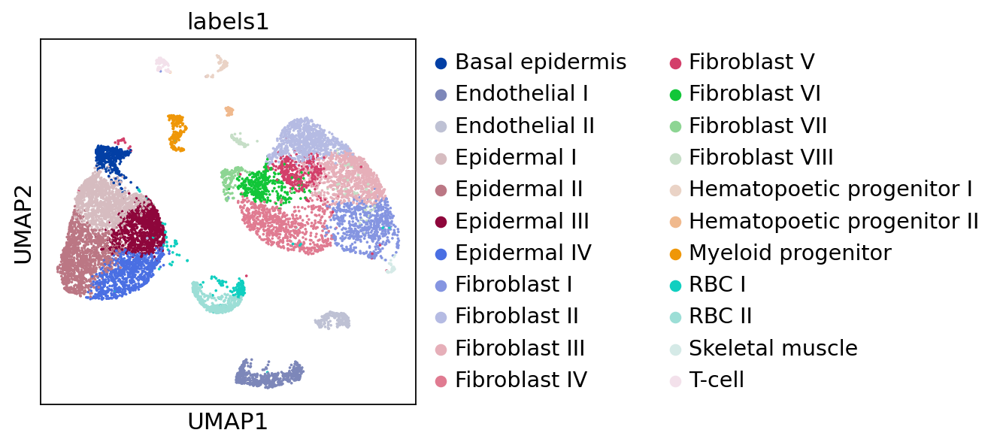

In [26]:
sc.pl.umap(intact,color=['labels1'])

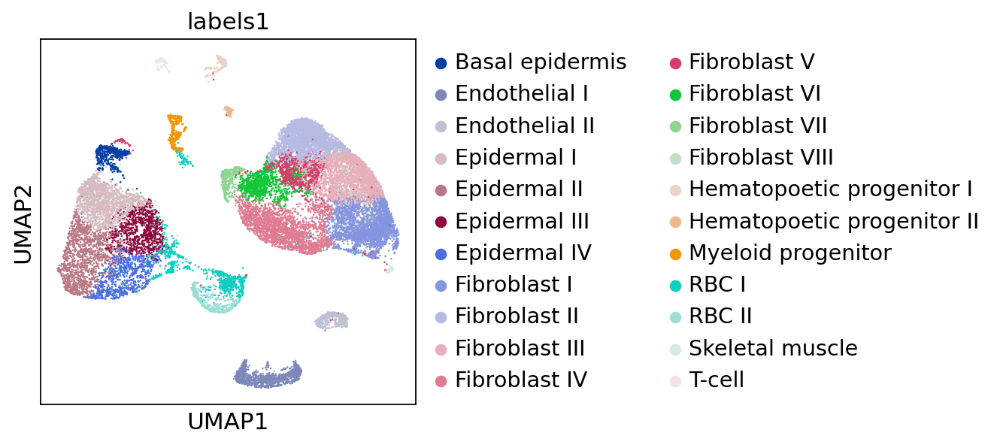

In [70]:
sc.pl.umap(contra,color=['labels1'])

In [27]:
intact_Velo = scv.utils.merge(intact, intact_loom)

In [28]:
contra_Velo = scv.utils.merge(contra, contra_loom)

In [29]:
intact_Velo.obs

,seq_folder,nUMI,nGene,percent.mt,log10GenesPerUMI,cells,sample,RNA_snn_res.0.8,seurat_clusters,RNA_snn_res.0.4,...,RNA_snn_res.1,labels1,sample_batch,Clusters,_X,_Y,batch,initial_size_spliced,initial_size_unspliced,initial_size
AAACCCAGTAAGTTAG,Intact_4N_1_S1,14646.0,912,0.000000,0.710560,Intact_4N_1_S1_AAACCCAGTAAGTTAG-1,intact,13,11,9,...,11,RBC I,Intact_4N_1_S1_-1,5,-16.065027,-33.539761,1,226,778,226.0
AAACCCAGTACCCGCA,Intact_4N_1_S1,3705.0,1451,0.000000,0.885922,Intact_4N_1_S1_AAACCCAGTACCCGCA-1,intact,9,8,6,...,21,Epidermal IV,Intact_4N_1_S1_-1,7,-7.042256,-3.068176,1,852,90,852.0
AAACCCATCTTAAGGC,Intact_4N_1_S1,11023.0,5216,0.000000,0.919610,Intact_4N_1_S1_AAACCCATCTTAAGGC-1,intact,5,5,2,...,4,Epidermal II,Intact_4N_1_S1_-1,1,12.769019,19.550514,1,8898,1782,8898.0
AAACGAAAGACATAGT,Intact_4N_1_S1,21566.0,6102,0.000000,0.873483,Intact_4N_1_S1_AAACGAAAGACATAGT-1,intact,1,2,0,...,1,Fibroblast III,Intact_4N_1_S1_-1,7,4.993493,1.223567,1,3571,2382,3571.0
AAACGAACACTGTGAT,Intact_4N_1_S1,46071.0,4446,0.000000,0.782251,Intact_4N_1_S1_AAACGAACACTGTGAT-1,intact,11,11,9,...,16,RBC I,Intact_4N_1_S1_-1,6,32.515800,-10.769389,1,5297,970,5297.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGAGTCAAACCTG,Intact_4N_5_S4,2730.0,1768,0.000000,0.945090,Intact_4N_5_S4_TTTGGAGTCAAACCTG-1,intact,4,5,4,...,3,Epidermal II,Intact_4N_5_S4_-1,2,20.065935,7.683801,2,10908,383,10908.0
TTTGGAGTCTTCTGTA,Intact_4N_5_S4,6099.0,2393,0.000000,0.892658,Intact_4N_5_S4_TTTGGAGTCTTCTGTA-1,intact,9,8,6,...,19,Epidermal IV,Intact_4N_5_S4_-1,1,3.015453,-21.316523,2,940,128,940.0
TTTGGTTAGCGATGAC,Intact_4N_5_S4,6149.0,3179,0.000000,0.924379,Intact_4N_5_S4_TTTGGTTAGCGATGAC-1,intact,6,1,1,...,0,Fibroblast II,Intact_4N_5_S4_-1,2,-3.079527,0.762511,2,7573,958,7573.0
TTTGTTGGTCTACGAT,Intact_4N_5_S4,30363.0,8697,0.003293,0.878864,Intact_4N_5_S4_TTTGTTGGTCTACGAT-1,intact,4,5,4,...,3,Epidermal II,Intact_4N_5_S4_-1,4,-1.053869,25.839836,2,17347,4054,17347.0


In [30]:
intact.obs

,seq_folder,nUMI,nGene,percent.mt,log10GenesPerUMI,cells,sample,RNA_snn_res.0.8,seurat_clusters,RNA_snn_res.0.4,nCount_RNA,nFeature_RNA,RNA_snn_res.0.6,RNA_snn_res.0.1,RNA_snn_res.1,labels1,sample_batch
AAACCCAGTAAGTTAG,Intact_4N_1_S1,14646.0,912,0.000000,0.710560,Intact_4N_1_S1_AAACCCAGTAAGTTAG-1,intact,13,11,9,14646.0,912,11,3,11,RBC I,Intact_4N_1_S1_-1
AAACCCAGTACCCGCA,Intact_4N_1_S1,3705.0,1451,0.000000,0.885922,Intact_4N_1_S1_AAACCCAGTACCCGCA-1,intact,9,8,6,3705.0,1451,8,1,21,Epidermal IV,Intact_4N_1_S1_-1
AAACCCATCTTAAGGC,Intact_4N_1_S1,11023.0,5216,0.000000,0.919610,Intact_4N_1_S1_AAACCCATCTTAAGGC-1,intact,5,5,2,11023.0,5216,5,1,4,Epidermal II,Intact_4N_1_S1_-1
AAACGAAAGACATAGT,Intact_4N_1_S1,21566.0,6102,0.000000,0.873483,Intact_4N_1_S1_AAACGAAAGACATAGT-1,intact,1,2,0,21566.0,6102,2,0,1,Fibroblast III,Intact_4N_1_S1_-1
AAACGAACACTGTGAT,Intact_4N_1_S1,46071.0,4446,0.000000,0.782251,Intact_4N_1_S1_AAACGAACACTGTGAT-1,intact,11,11,9,46071.0,4446,11,3,16,RBC I,Intact_4N_1_S1_-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGAGTCAAACCTG,Intact_4N_5_S4,2730.0,1768,0.000000,0.945090,Intact_4N_5_S4_TTTGGAGTCAAACCTG-1,intact,4,5,4,2730.0,1768,5,1,3,Epidermal II,Intact_4N_5_S4_-1
TTTGGAGTCTTCTGTA,Intact_4N_5_S4,6099.0,2393,0.000000,0.892658,Intact_4N_5_S4_TTTGGAGTCTTCTGTA-1,intact,9,8,6,6099.0,2393,8,1,19,Epidermal IV,Intact_4N_5_S4_-1
TTTGGTTAGCGATGAC,Intact_4N_5_S4,6149.0,3179,0.000000,0.924379,Intact_4N_5_S4_TTTGGTTAGCGATGAC-1,intact,6,1,1,6149.0,3179,1,0,0,Fibroblast II,Intact_4N_5_S4_-1
TTTGTTGGTCTACGAT,Intact_4N_5_S4,30363.0,8697,0.003293,0.878864,Intact_4N_5_S4_TTTGTTGGTCTACGAT-1,intact,4,5,4,30363.0,8697,5,1,3,Epidermal II,Intact_4N_5_S4_-1


findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial


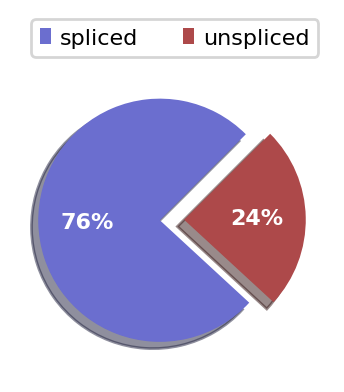

In [31]:
scv.pl.proportions(intact_Velo)

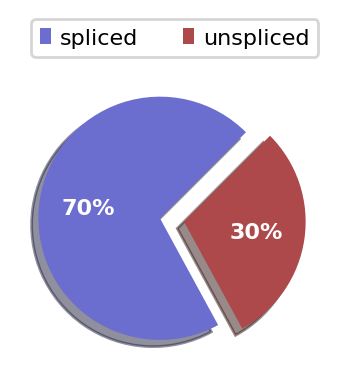

In [32]:
scv.pl.proportions(contra_Velo)

In [33]:
scv.pp.filter_and_normalize(intact_Velo, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(intact_Velo, n_pcs=30, n_neighbors=30)
scv.pp.filter_and_normalize(contra_Velo, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(contra_Velo, n_pcs=30, n_neighbors=30)

Filtered out 481 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
computing neighbors
    finished (0:00:33) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
Filtered out 468 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
computing neighbors
    finished (0:00:05) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [34]:
scv.tl.velocity(intact_Velo)
scv.tl.velocity(contra_Velo)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [35]:
scv.tl.velocity_graph(intact_Velo)
scv.tl.velocity_graph(contra_Velo)

computing velocity graph (using 1/12 cores)


  0%|          | 0/10950 [00:00<?, ?cells/s]

    finished (0:00:22) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity graph (using 1/12 cores)


  0%|          | 0/22650 [00:00<?, ?cells/s]

    finished (0:00:51) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:06) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial


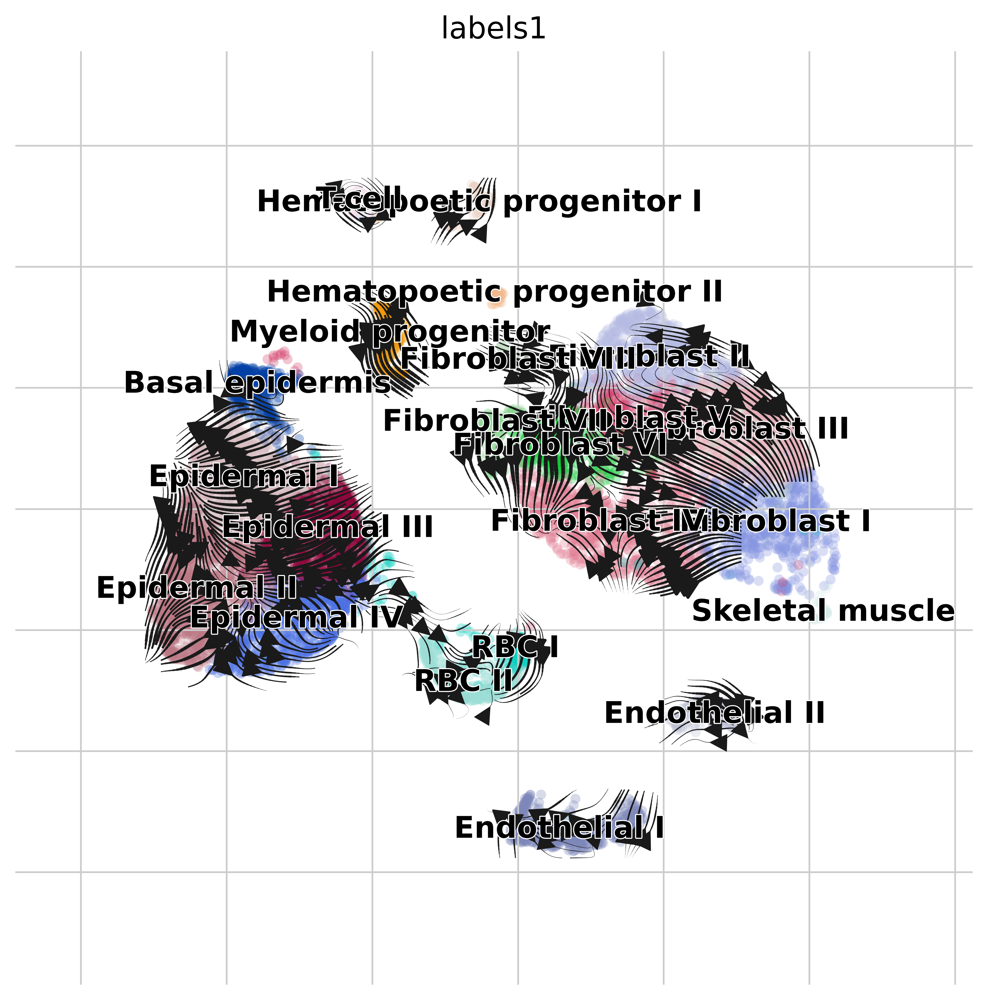

In [36]:
scv.pl.velocity_embedding_stream(intact_Velo, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (8,8), arrow_size = 2, density = 6)

computing velocity embedding
    finished (0:00:13) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


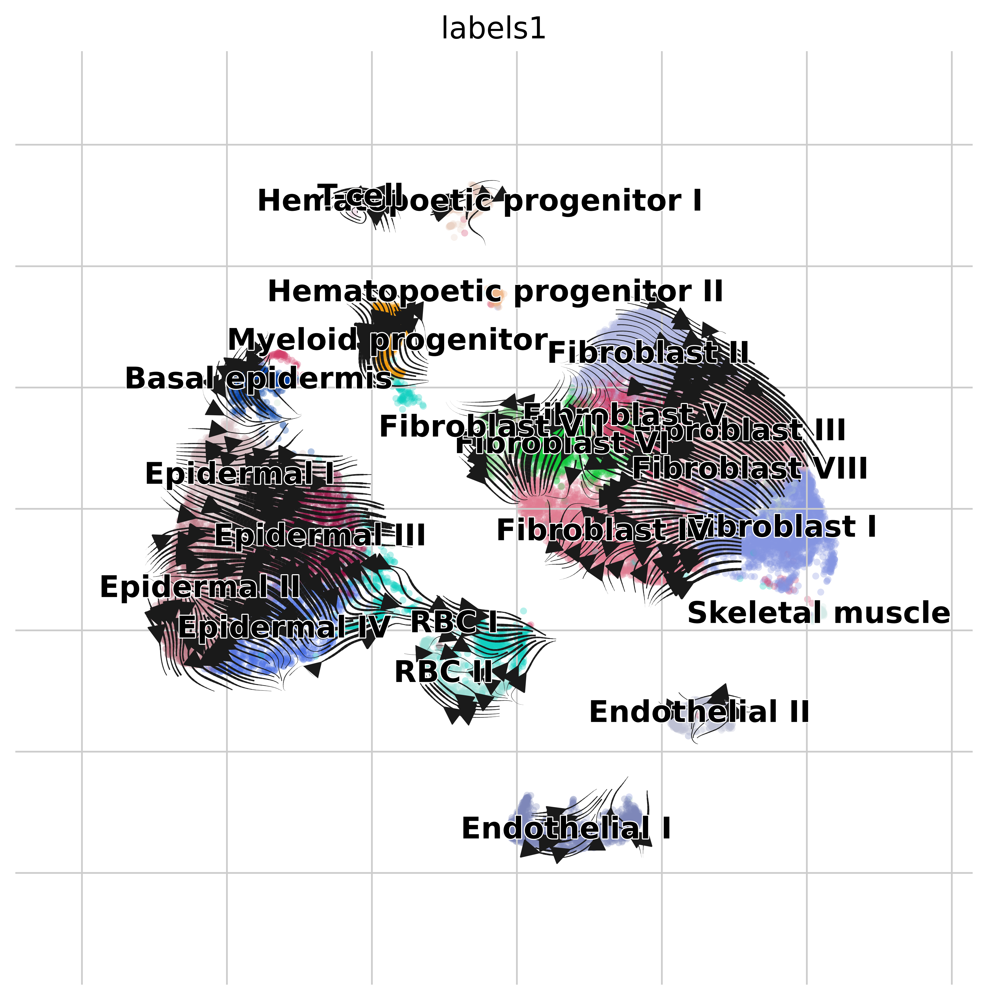

In [37]:
scv.pl.velocity_embedding_stream(contra_Velo, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (8,8), arrow_size = 2, density = 6)

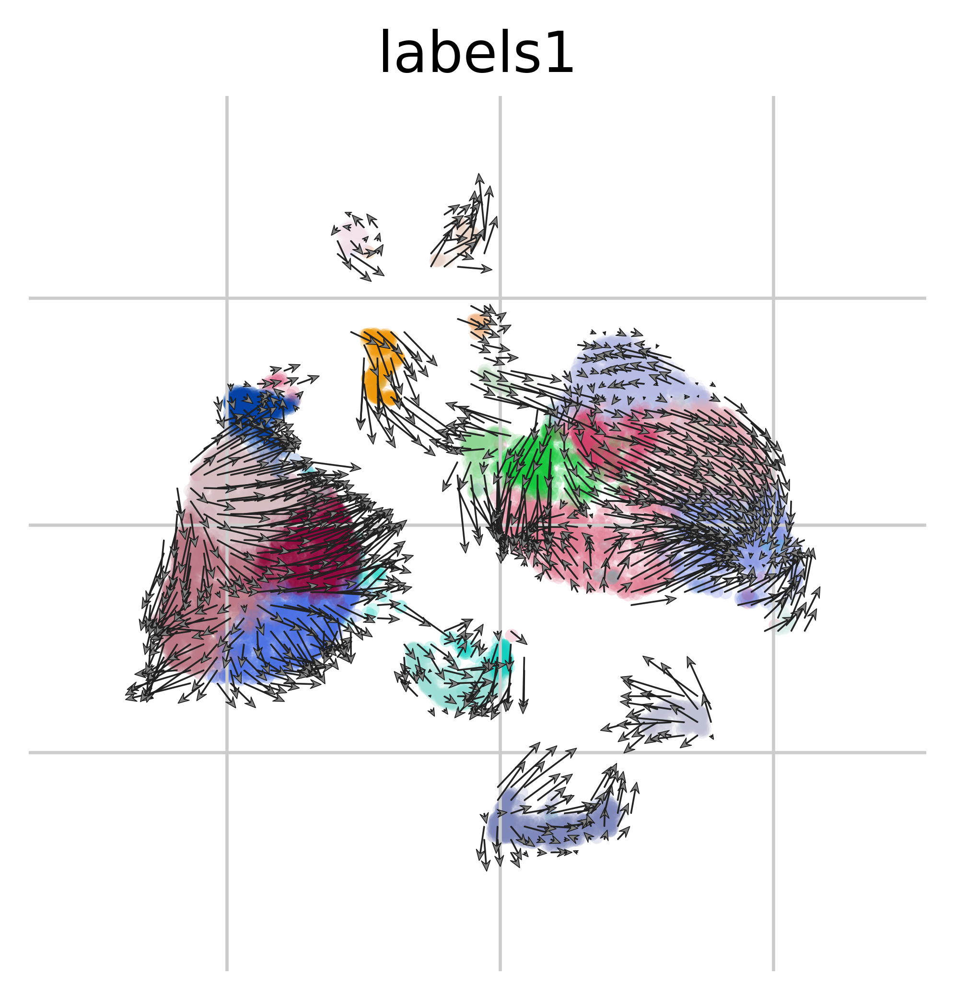

In [45]:
scv.pl.velocity_embedding_grid(intact_Velo, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (4,4), arrow_length = 16, arrow_size = 2, density = 1)

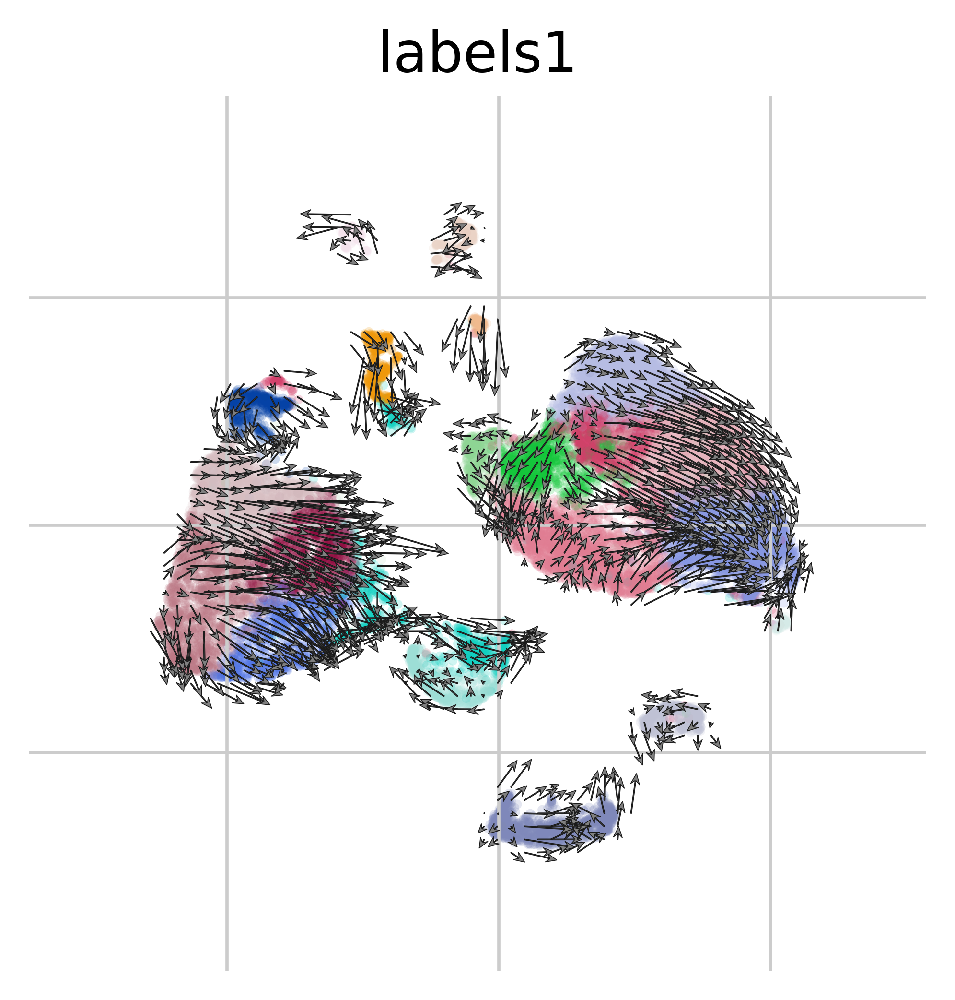

In [46]:
scv.pl.velocity_embedding_grid(contra_Velo, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (4,4), arrow_length = 16, arrow_size = 2, density = 1)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


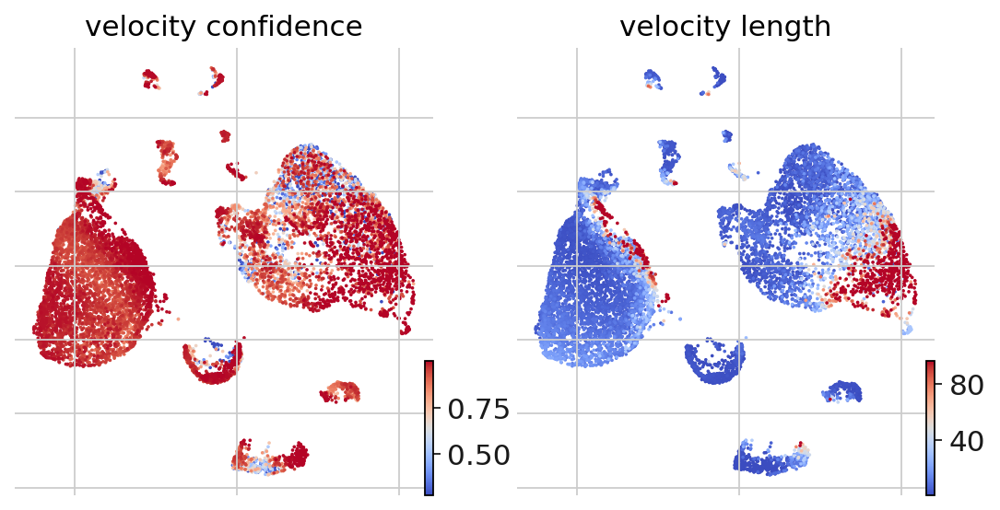

In [47]:
scv.tl.velocity_confidence(intact_Velo)
keys =  'velocity_confidence','velocity_length'
scv.pl.scatter(intact_Velo, c=keys, cmap='coolwarm', perc=[5, 95])

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


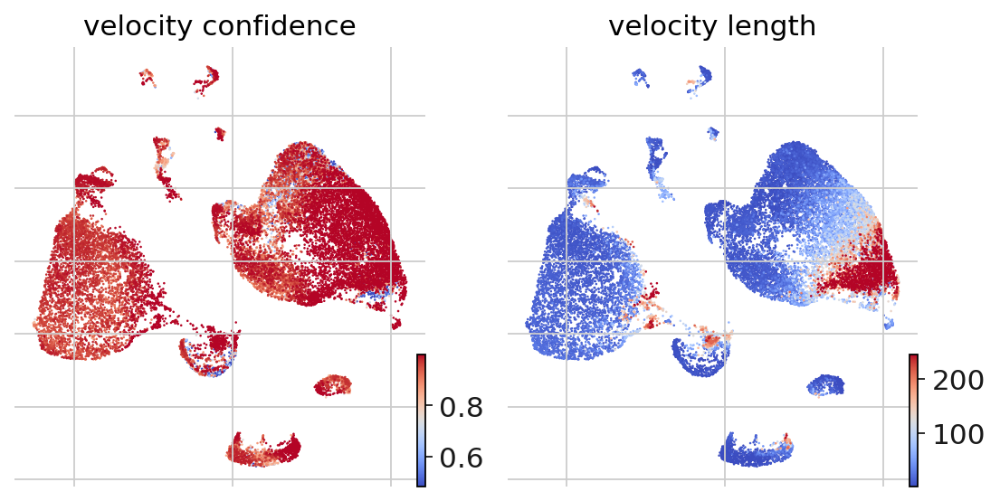

In [48]:
scv.tl.velocity_confidence(contra_Velo)
keys =  'velocity_confidence','velocity_length'
scv.pl.scatter(contra_Velo, c=keys, cmap='coolwarm', perc=[5, 95])

computing terminal states
    identified 6 regions of root cells and 2 regions of end points .
    finished (0:00:19) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


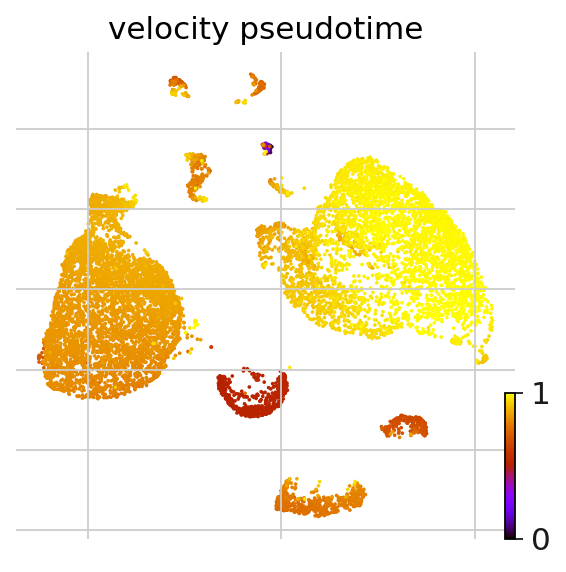

In [49]:
scv.tl.velocity_pseudotime(intact_Velo)
scv.pl.scatter(intact_Velo, color='velocity_pseudotime', cmap='gnuplot')

computing terminal states
    identified 7 regions of root cells and 1 region of end points .
    finished (0:00:25) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


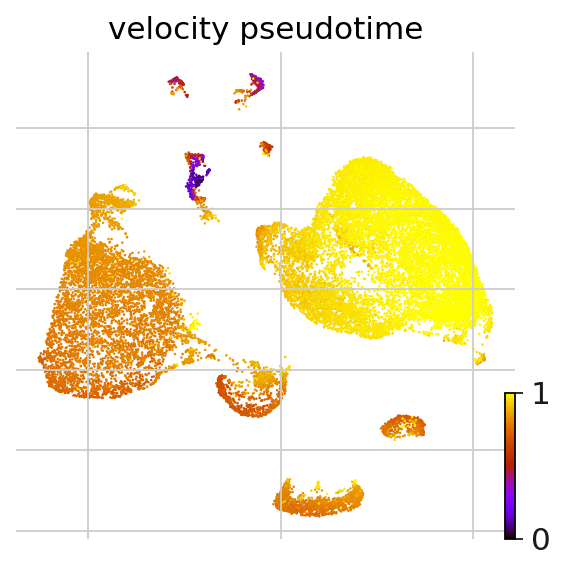

In [50]:
scv.tl.velocity_pseudotime(contra_Velo)
scv.pl.scatter(contra_Velo, color='velocity_pseudotime', cmap='gnuplot')

In [52]:
scv.tl.recover_dynamics(intact_Velo)

recovering dynamics (using 1/12 cores)


  0%|          | 0/29 [00:00<?, ?gene/s]

    finished (0:00:43) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [53]:
scv.tl.recover_dynamics(contra_Velo)

recovering dynamics (using 1/12 cores)


  0%|          | 0/47 [00:00<?, ?gene/s]

    finished (0:02:20) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [54]:
scv.tl.velocity(intact_Velo, mode='dynamical')
scv.tl.velocity_graph(intact_Velo)
scv.tl.velocity(contra_Velo, mode='dynamical')
scv.tl.velocity_graph(contra_Velo)

computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)


  0%|          | 0/10950 [00:00<?, ?cells/s]

    finished (0:00:21) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocities
    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)


  0%|          | 0/22650 [00:00<?, ?cells/s]

    finished (0:00:36) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:06) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


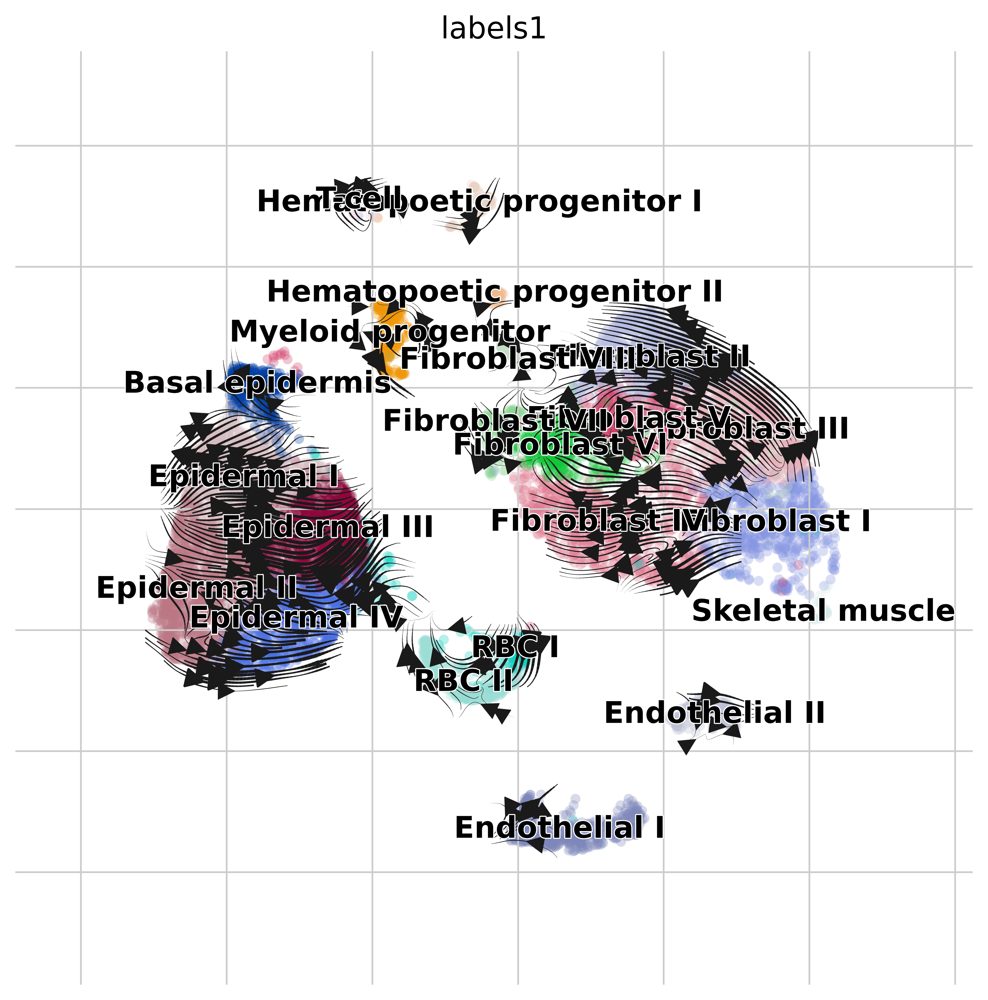

In [55]:
scv.pl.velocity_embedding_stream(intact_Velo, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (8,8), arrow_size = 2, density = 6)

computing velocity embedding
    finished (0:00:12) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


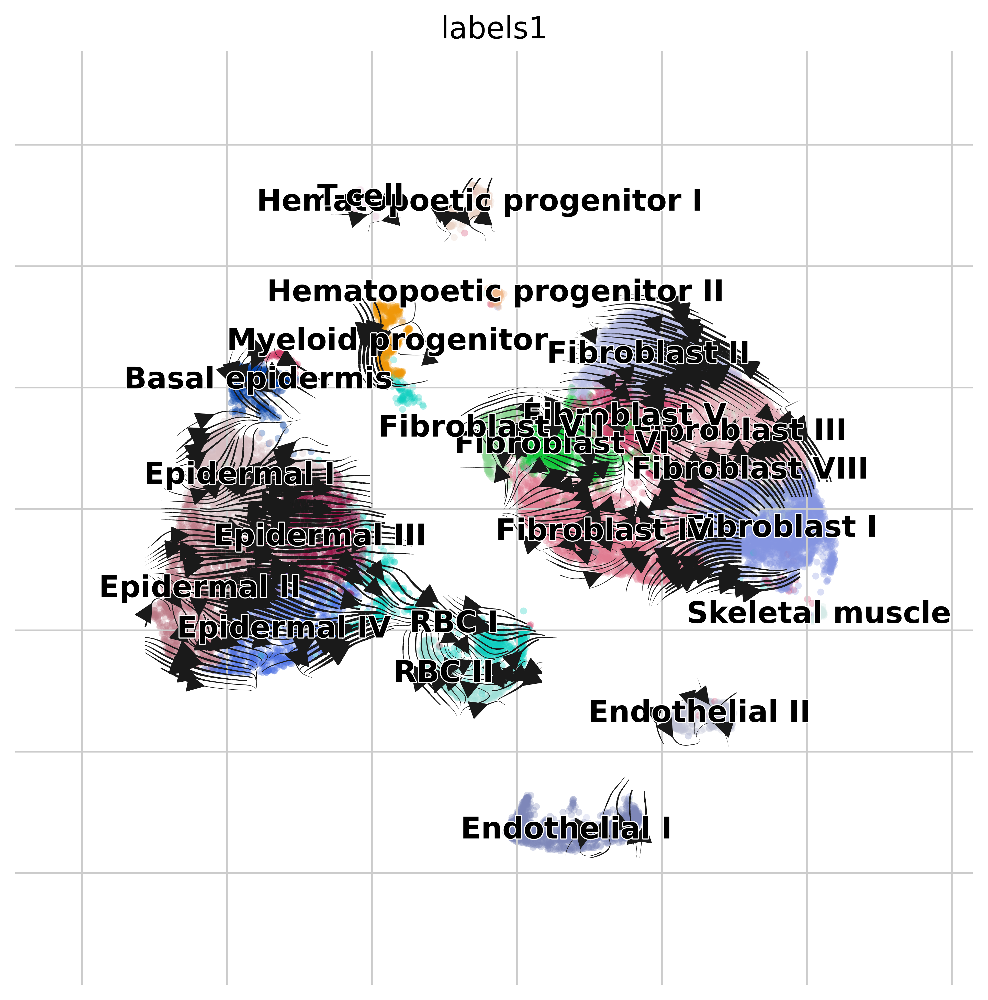

In [56]:
scv.pl.velocity_embedding_stream(contra_Velo, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (8,8), arrow_size = 2, density = 6)

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial


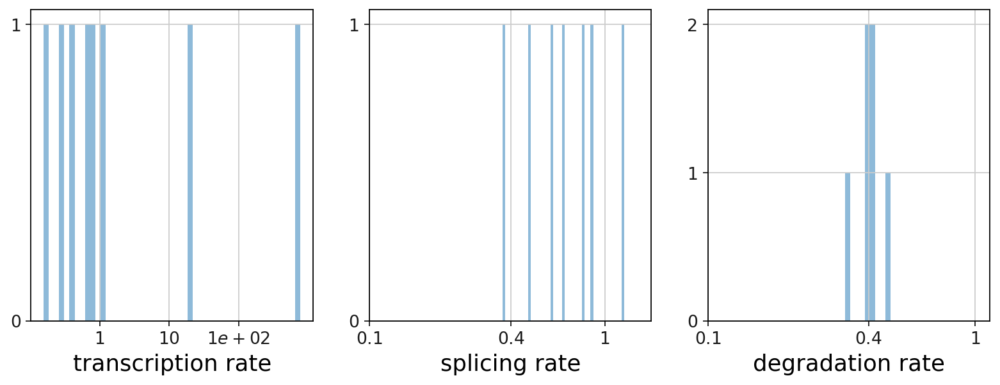

,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,fit_r2
AMEX60DDU001000269,0.608597,2.687382,0.302863,5.776603,0.378312,0.070274,0.259132,3.059006e-04,0.0,0.0,0.476189,0.156442,1.647522,2.493389,1.261474,0.021071
AMEX60DDU001001741,0.667664,0.436524,0.294829,2.640398,3.943321,0.342245,0.150366,3.534669e-06,0.0,0.0,0.493261,1.117362,0.873999,1.337843,0.862693,0.153167
AMEX60DDU001001994,10.957922,15.290503,0.810694,17.044110,0.065890,0.161804,2.861767,4.792898e-09,0.0,0.0,0.497989,0.828289,14.783561,0.823941,1.070073,0.538484
AMEX60DDU001007977,0.266587,0.317311,0.390372,8.230240,1.862949,0.266250,0.180911,1.362336e-01,0.0,0.0,0.478867,0.865120,0.486173,1.286517,1.937425,0.246978
AMEX60DDU001011044,0.187664,1.286236,0.280608,3.422996,1.064785,0.058253,0.090269,6.242921e-13,0.0,0.0,0.238759,0.165470,0.205356,0.634162,1.265001,0.145771


In [57]:
df = intact_Velo.var
df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

kwargs = dict(xscale='log', fontsize=16)
with scv.GridSpec(ncols=3) as pl:
    pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
    pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
    pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)

scv.get_df(intact_Velo, 'fit*', dropna=True).head()

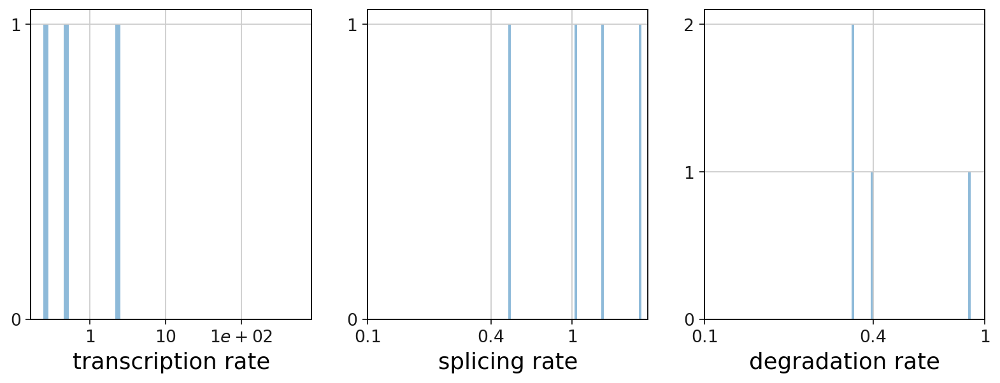

,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,fit_r2
AMEX60DDU001000269,0.072406,0.336479,0.215564,3.451217,3.042536,0.069064,0.034049,1.839756e-16,0.0,0.0,0.327304,0.210097,0.099752,1.690154,1.391942,0.225240
AMEX60DDU001001741,0.096694,0.105454,0.320401,5.763633,4.848644,0.337358,0.057982,4.372653e-02,0.0,0.0,0.445460,1.454848,0.178939,3.263973,1.629803,0.153155
AMEX60DDU001001994,9.636376,15.565994,0.735160,18.655212,0.090257,0.128511,2.317295,1.403615e-18,0.0,0.0,0.498990,0.494023,11.924145,1.094495,0.992925,0.524267
AMEX60DDU001007334,6.709232,23.831945,0.355374,1.861247,0.083560,0.083657,1.734512,6.650337e-06,0.0,0.0,0.498123,0.220172,6.395486,1.811542,0.745706,0.014258
AMEX60DDU001007977,0.244241,0.269039,0.335938,4.529583,3.860551,0.309090,0.124099,1.855723e-01,0.0,0.0,0.454691,1.141996,0.392006,0.780770,1.423437,0.120450


In [58]:
df = contra_Velo.var
df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

kwargs = dict(xscale='log', fontsize=16)
with scv.GridSpec(ncols=3) as pl:
    pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
    pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
    pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)

scv.get_df(contra_Velo, 'fit*', dropna=True).head()

computing latent time using root_cells as prior
    finished (0:00:05) --> added 
    'latent_time', shared time (adata.obs)


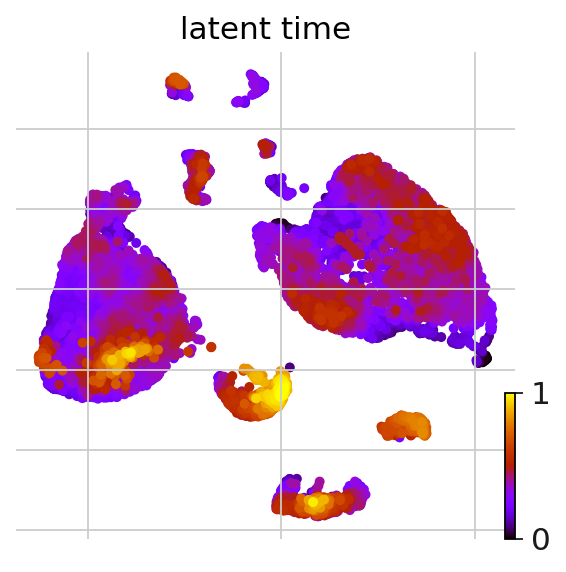

In [59]:
scv.tl.latent_time(intact_Velo)
scv.pl.scatter(intact_Velo, color='latent_time', color_map='gnuplot', size=80)

computing latent time using root_cells as prior
    finished (0:00:12) --> added 
    'latent_time', shared time (adata.obs)


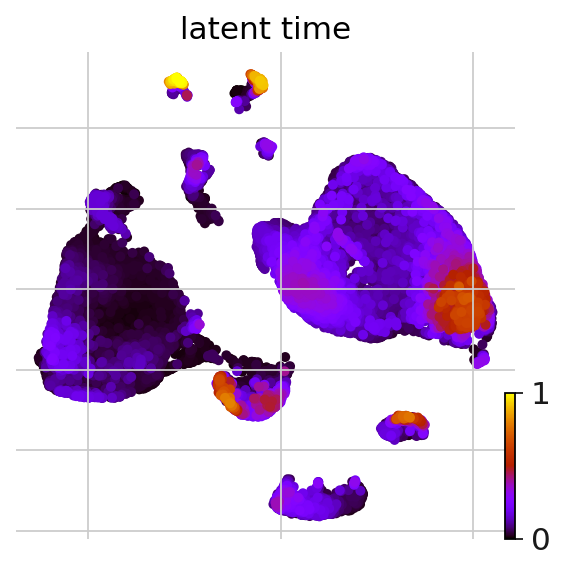

In [60]:
scv.tl.latent_time(contra_Velo)
scv.pl.scatter(contra_Velo, color='latent_time', color_map='gnuplot', size=80)

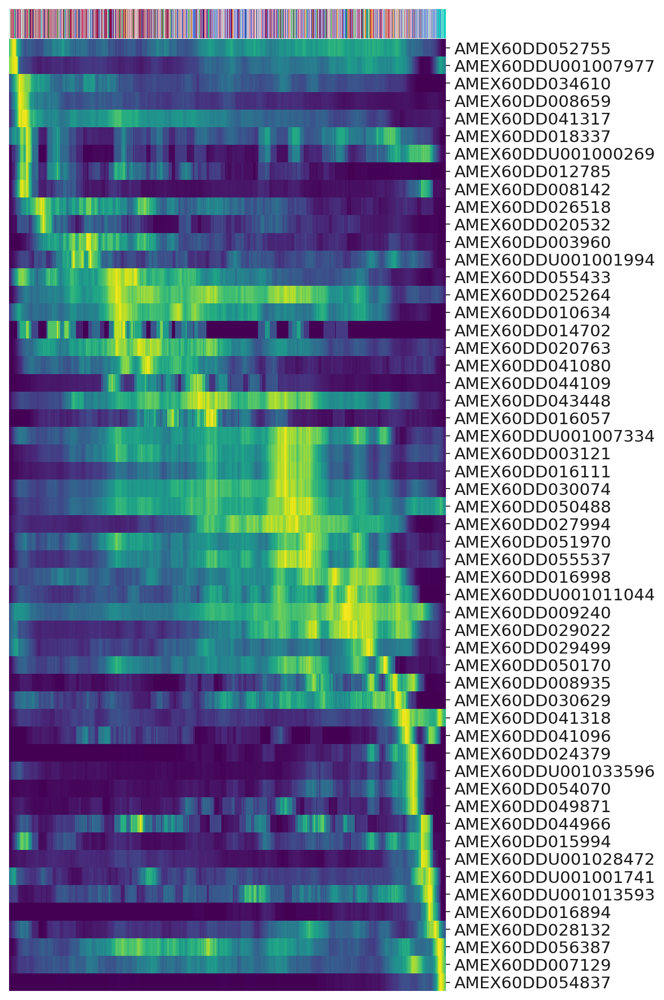

In [138]:
top_genes = intact_Velo.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(intact_Velo, var_names=top_genes, sortby='latent_time', col_color='labels1', n_convolve=300,yticklabels=True, figsize = (8,12))


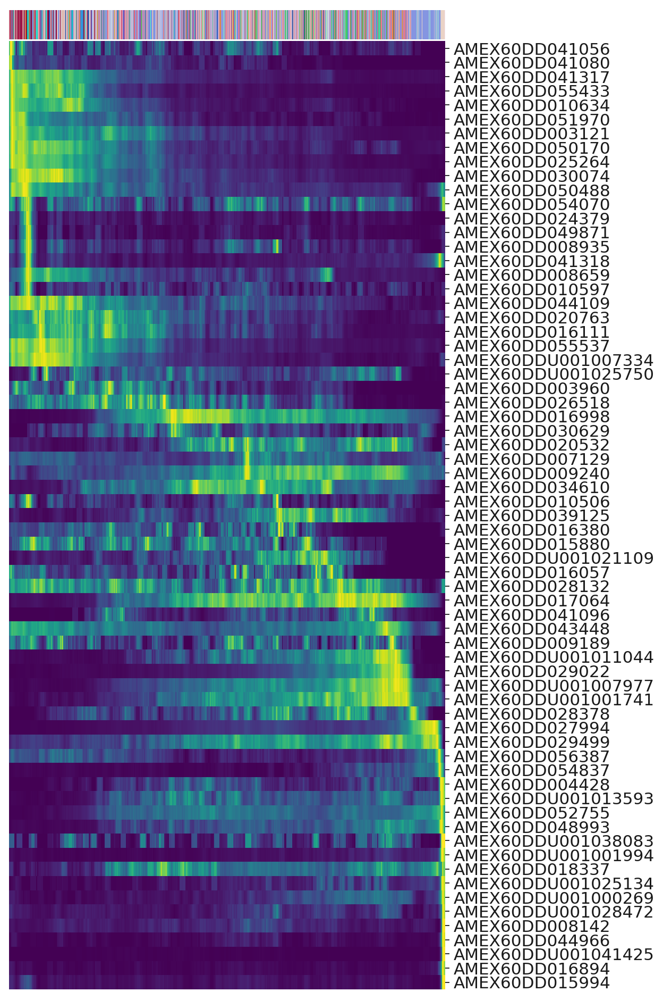

In [139]:
top_genes = contra_Velo.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(contra_Velo, var_names=top_genes, sortby='latent_time', col_color='labels1', n_convolve=300,yticklabels=True, figsize = (8,12))
#AMEX60DD041056

In [63]:
scv.tl.score_genes_cell_cycle(intact_Velo)
scv.pl.scatter(intact_Velo, color_gradients=['S_score', 'G2M_score'], smooth=True, perc=[5, 95])

calculating cell cycle phase
computing score 'S_score'


ValueError: No valid genes were passed for scoring.

In [ ]:
scv.tl.score_genes_cell_cycle(contra_Velo)
scv.pl.scatter(contra_Velo, color_gradients=['S_score', 'G2M_score'], smooth=True, perc=[5, 95])

In [66]:
intact_Velo.uns['neighbors']['distances'] = intact_Velo.obsp['distances']
intact_Velo.uns['neighbors']['connectivities'] = intact_Velo.obsp['connectivities']

scv.tl.paga(intact_Velo, groups='labels1')
df = scv.get_df(intact_Velo, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:06) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21
0,0,0,0,0.13,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0.012,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0.017,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0.18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0.23,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0.25,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [67]:
contra_Velo.uns['neighbors']['distances'] = contra_Velo.obsp['distances']
contra_Velo.uns['neighbors']['connectivities'] = contra_Velo.obsp['connectivities']

scv.tl.paga(contra_Velo, groups='labels1')
df = scv.get_df(contra_Velo, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:11) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21
0,0,0,0,0.068,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0.02,0,0,0,0,0,0,0,0,0,0,0,0.014,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0.23,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0.1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0.13,0,0,0,0,0,0,0,0,0,0,0,0.058,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial


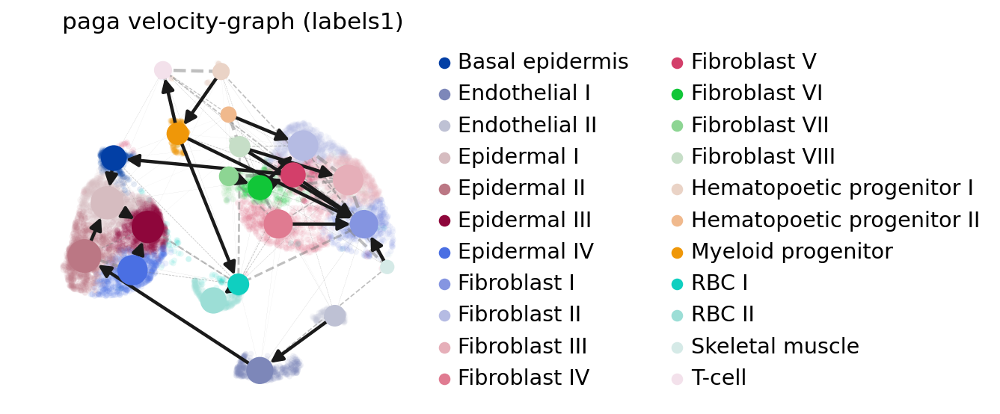

In [68]:
scv.pl.paga(intact_Velo, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5)

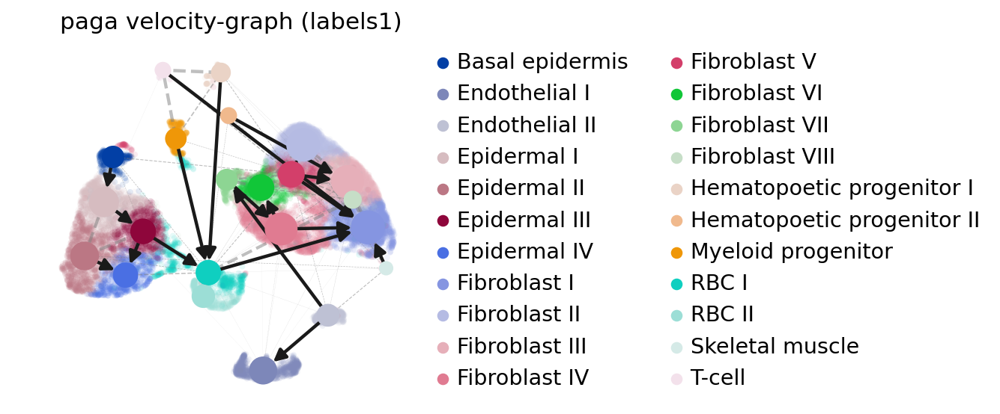

In [69]:
scv.pl.paga(contra_Velo, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5)

In [71]:
intact_Velo_subset = intact_Velo[intact_Velo.obs['labels1'].isin(['Epidermal III','RBC I','RBC II'])]

In [72]:
contra_Velo_subset = contra_Velo[contra_Velo.obs['labels1'].isin(['Epidermal III','RBC I','RBC II'])]

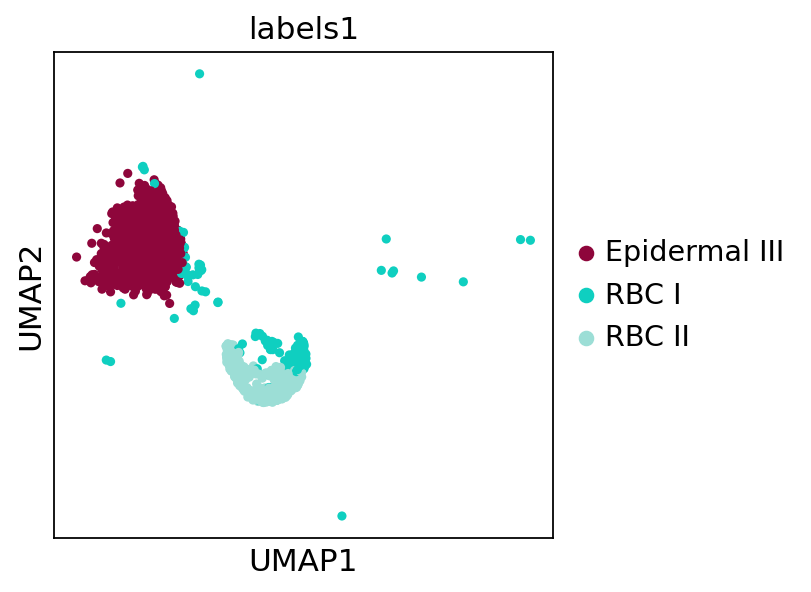

In [73]:
sc.pl.umap(intact_Velo_subset,color=['labels1'])

In [74]:
sc.tl.umap(intact_Velo_subset)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


In [75]:
sc.tl.umap(contra_Velo_subset)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)


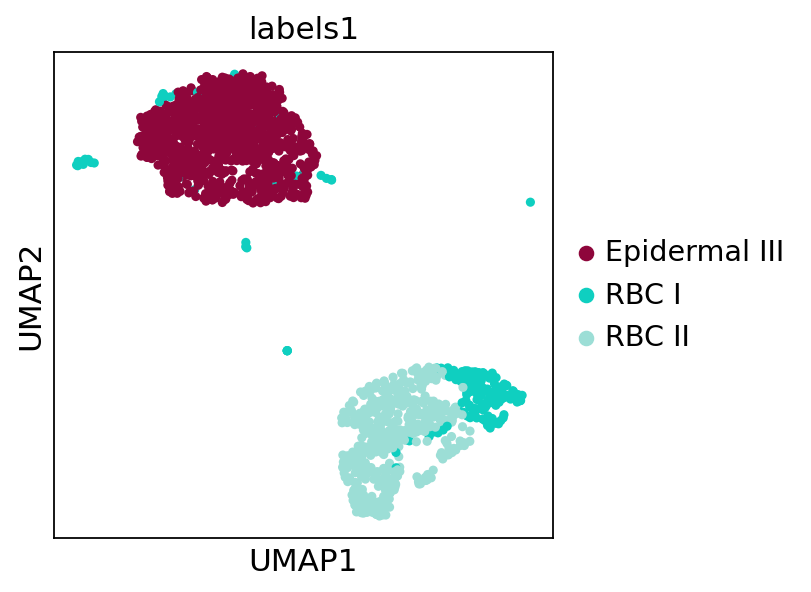

In [76]:
sc.pl.umap(intact_Velo_subset,color=['labels1'])

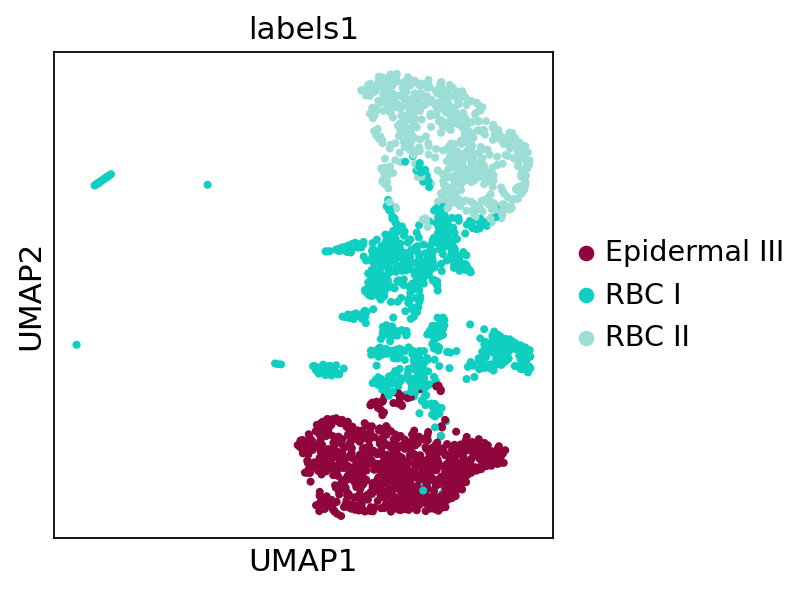

In [77]:
sc.pl.umap(contra_Velo_subset,color=['labels1'])

In [78]:
Velo_subset = intact_Velo_subset.concatenate(contra_Velo_subset)

In [80]:
sc.pp.neighbors(Velo_subset)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [81]:
sc.tl.umap(Velo_subset)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:14)


In [82]:
Velo_subset.obs

,seq_folder,nUMI,nGene,percent.mt,log10GenesPerUMI,cells,sample,RNA_snn_res.0.8,seurat_clusters,RNA_snn_res.0.4,...,initial_size,n_counts,velocity_self_transition,velocity_length,velocity_confidence,velocity_confidence_transition,root_cells,end_points,velocity_pseudotime,latent_time
AAACCCAGTAAGTTAG-0,Intact_4N_1_S1,14646.0,912,0.00,0.71,Intact_4N_1_S1_AAACCCAGTAAGTTAG-1,intact,13,11,9,...,226.0,-12.73,1.29e-03,3.99,1.00,0.99,4.17e-05,1.47e-01,0.59,9.82e-01
AAACGAACACTGTGAT-0,Intact_4N_1_S1,46071.0,4446,0.00,0.78,Intact_4N_1_S1_AAACGAACACTGTGAT-1,intact,11,11,9,...,5297.0,-1.61,6.79e-02,1.96,0.82,1.00,3.48e-03,1.99e-01,0.59,7.77e-01
AAACGAAGTACAAACA-0,Intact_4N_1_S1,6207.0,3039,0.00,0.92,Intact_4N_1_S1_AAACGAAGTACAAACA-1,intact,3,6,4,...,6764.0,18.73,6.50e-03,4.16,0.92,0.80,8.30e-05,3.58e-07,0.86,2.75e-01
AAACGAAGTTGCTGAT-0,Intact_4N_1_S1,6072.0,2877,0.00,0.91,Intact_4N_1_S1_AAACGAAGTTGCTGAT-1,intact,3,6,2,...,6858.0,11.64,1.18e-03,31.01,1.00,1.00,2.71e-05,2.68e-06,0.90,1.48e-01
AAACGCTAGTCGCGAA-0,Intact_4N_1_S1,25945.0,1061,0.00,0.69,Intact_4N_1_S1_AAACGCTAGTCGCGAA-1,intact,11,11,9,...,442.0,-11.01,1.90e-04,4.50,0.96,1.00,9.29e-05,1.81e-01,0.59,8.88e-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGATCTCTACAGGT-1,Contra_4N_5_S8,2495.0,1155,0.00,0.90,Contra_4N_5_S8_TTTGATCTCTACAGGT-1,contra,3,6,2,...,5716.0,7.14,2.58e-04,11.74,0.99,0.84,1.84e-04,1.59e-07,0.10,2.08e-02
TTTGGAGAGAAGCCAC-1,Contra_4N_5_S8,7889.0,3762,0.01,0.92,Contra_4N_5_S8_TTTGGAGAGAAGCCAC-1,contra,3,6,4,...,8430.0,30.45,8.55e-03,11.22,0.98,0.51,7.48e-04,1.64e-07,0.10,7.79e-03
TTTGGAGGTCCTACAA-1,Contra_4N_5_S8,16498.0,2118,0.00,0.79,Contra_4N_5_S8_TTTGGAGGTCCTACAA-1,contra,13,12,10,...,838.0,-11.17,5.91e-03,2.45,0.93,0.14,7.55e-05,3.10e-04,0.43,3.83e-01
TTTGTTGGTGGCGTAA-1,Contra_4N_5_S8,9088.0,3462,0.00,0.89,Contra_4N_5_S8_TTTGTTGGTGGCGTAA-1,contra,3,6,6,...,7000.0,15.56,3.74e-04,52.56,0.99,0.98,2.09e-04,1.88e-07,0.11,2.49e-03


In [83]:
intact_Velo_subset = Velo_subset[Velo_subset.obs['sample'].isin(['intact'])]

In [84]:
contra_Velo_subset = Velo_subset[Velo_subset.obs['sample'].isin(['contra'])]

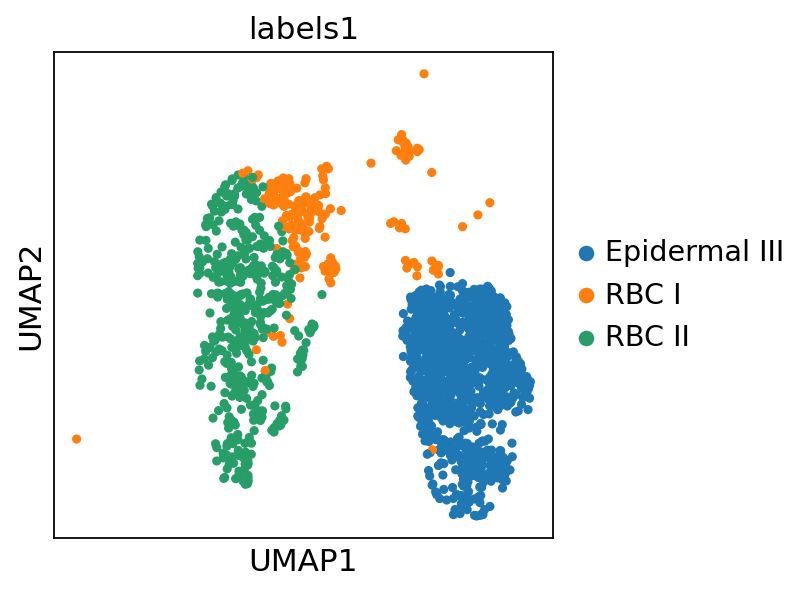

In [85]:
sc.pl.umap(intact_Velo_subset,color=['labels1'])

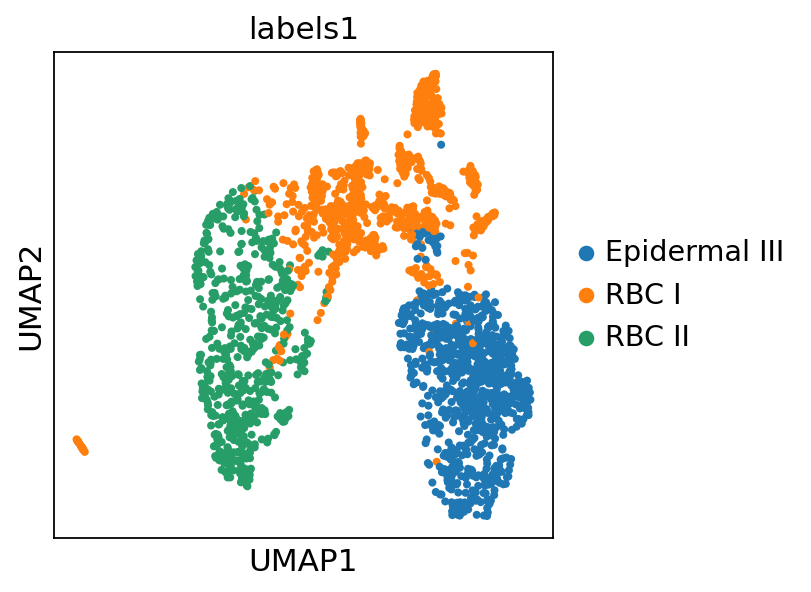

In [86]:
sc.pl.umap(contra_Velo_subset,color=['labels1'])

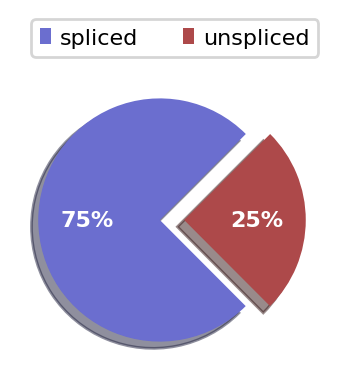

In [87]:
scv.pl.proportions(intact_Velo_subset)

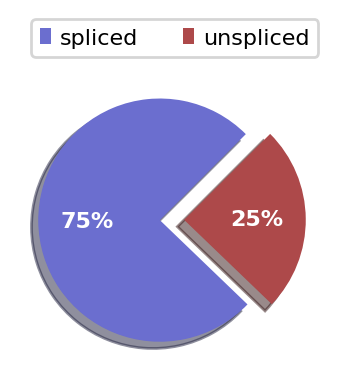

In [88]:
scv.pl.proportions(contra_Velo_subset)

In [89]:
scv.tl.velocity(intact_Velo_subset)
scv.tl.velocity(contra_Velo_subset)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [91]:
sc.pp.neighbors(intact_Velo_subset)
sc.pp.neighbors(contra_Velo_subset)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [92]:
scv.tl.velocity_graph(intact_Velo_subset)
scv.tl.velocity_graph(contra_Velo_subset)

computing velocity graph (using 1/12 cores)


  0%|          | 0/1764 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity graph (using 1/12 cores)


  0%|          | 0/2295 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


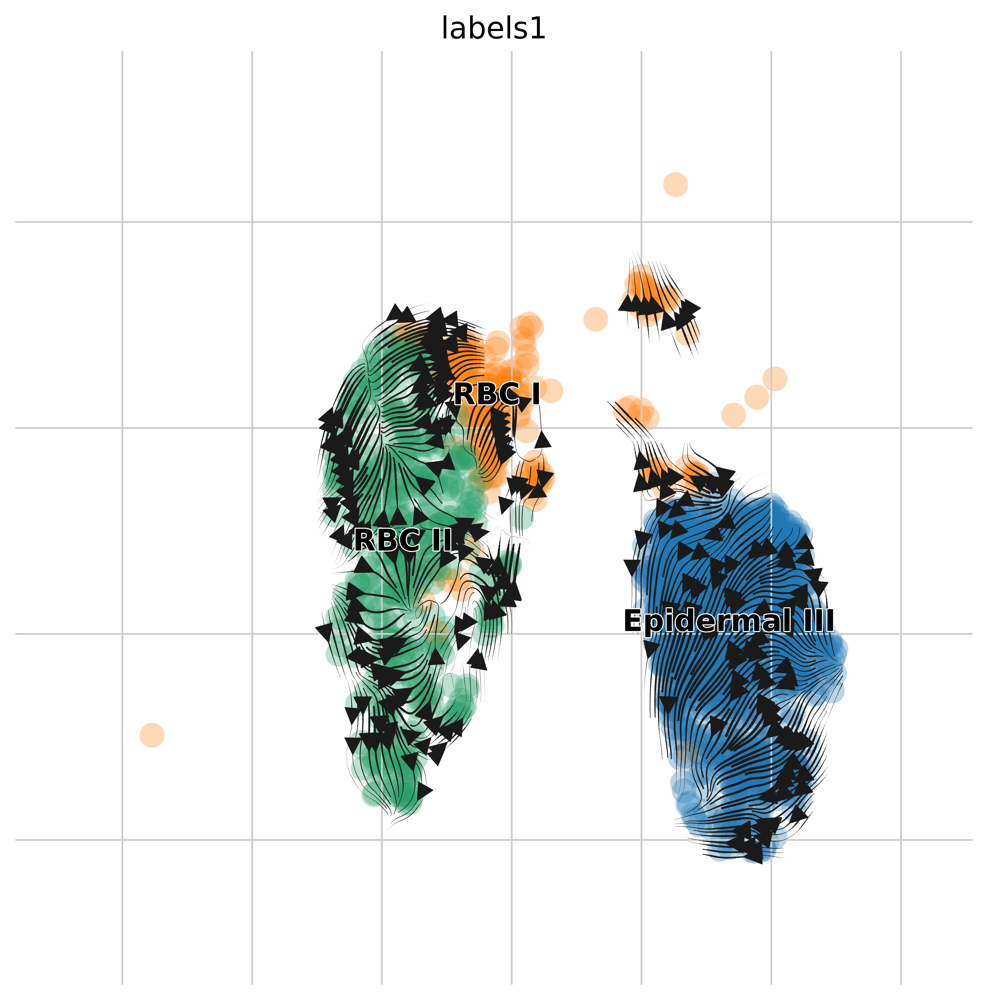

In [93]:
scv.pl.velocity_embedding_stream(intact_Velo_subset, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (8,8), arrow_size = 2, density = 6)

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


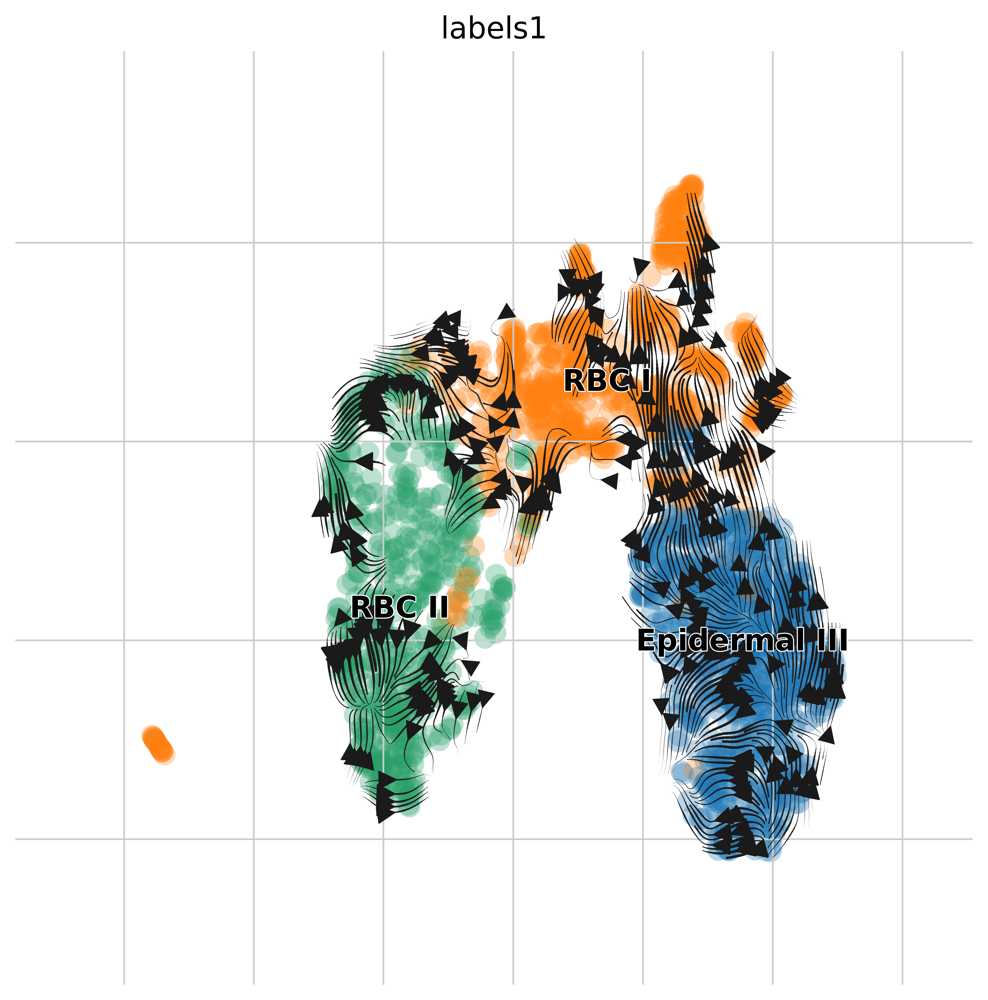

In [94]:
scv.pl.velocity_embedding_stream(contra_Velo_subset, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (8,8), arrow_size = 2, density = 6)

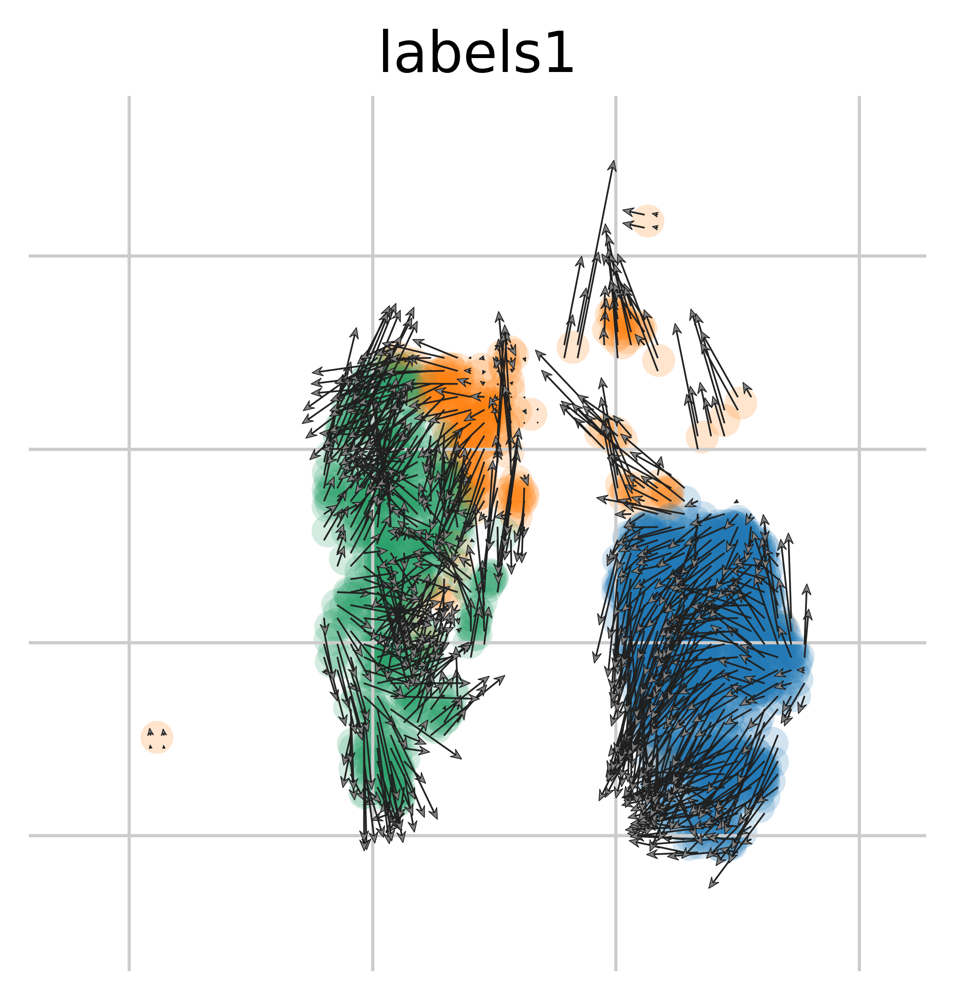

In [95]:
scv.pl.velocity_embedding_grid(intact_Velo_subset, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (4,4), arrow_length = 16, arrow_size = 2, density = 1)

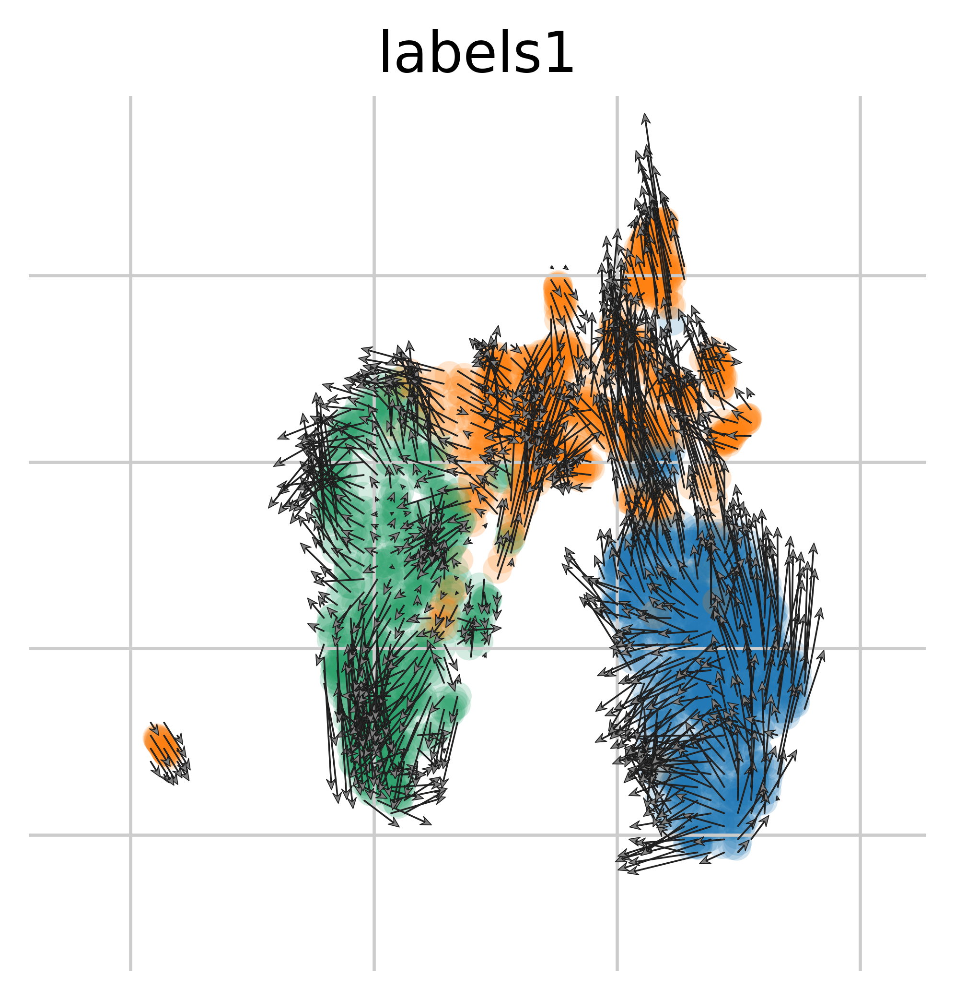

In [96]:
scv.pl.velocity_embedding_grid(contra_Velo_subset, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (4,4), arrow_length = 16, arrow_size = 2, density = 1)

In [97]:
scv.tl.recover_dynamics(intact_Velo_subset)
scv.tl.recover_dynamics(contra_Velo_subset)

recovering dynamics (using 1/12 cores)


  0%|          | 0/12 [00:00<?, ?gene/s]

    finished (0:00:04) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
recovering dynamics (using 1/12 cores)


  0%|          | 0/11 [00:00<?, ?gene/s]

    finished (0:00:04) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [98]:
scv.tl.velocity(intact_Velo_subset, mode='dynamical')
scv.tl.velocity_graph(intact_Velo_subset)
scv.tl.velocity(contra_Velo_subset, mode='dynamical')
scv.tl.velocity_graph(contra_Velo_subset)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)


  0%|          | 0/1764 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)


  0%|          | 0/2295 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


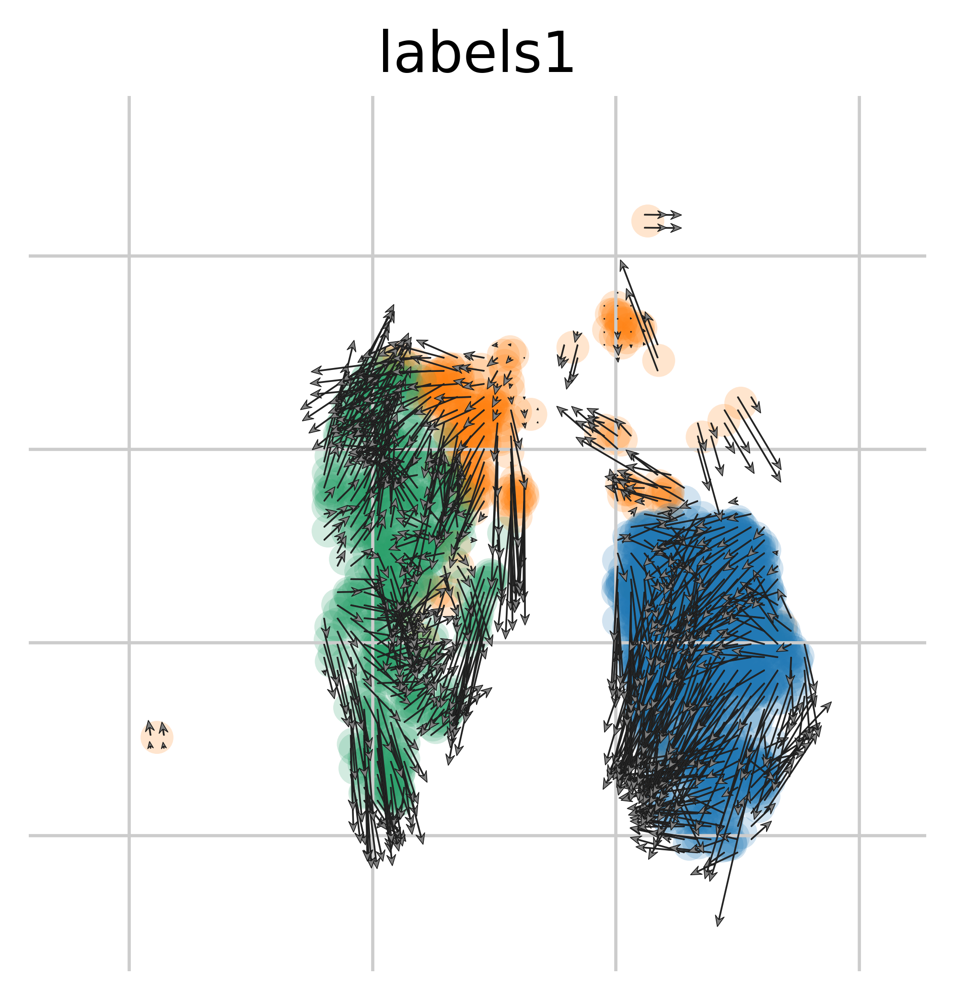

In [99]:
scv.pl.velocity_embedding_grid(intact_Velo_subset, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (4,4), arrow_length = 16, arrow_size = 2, density = 1)

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


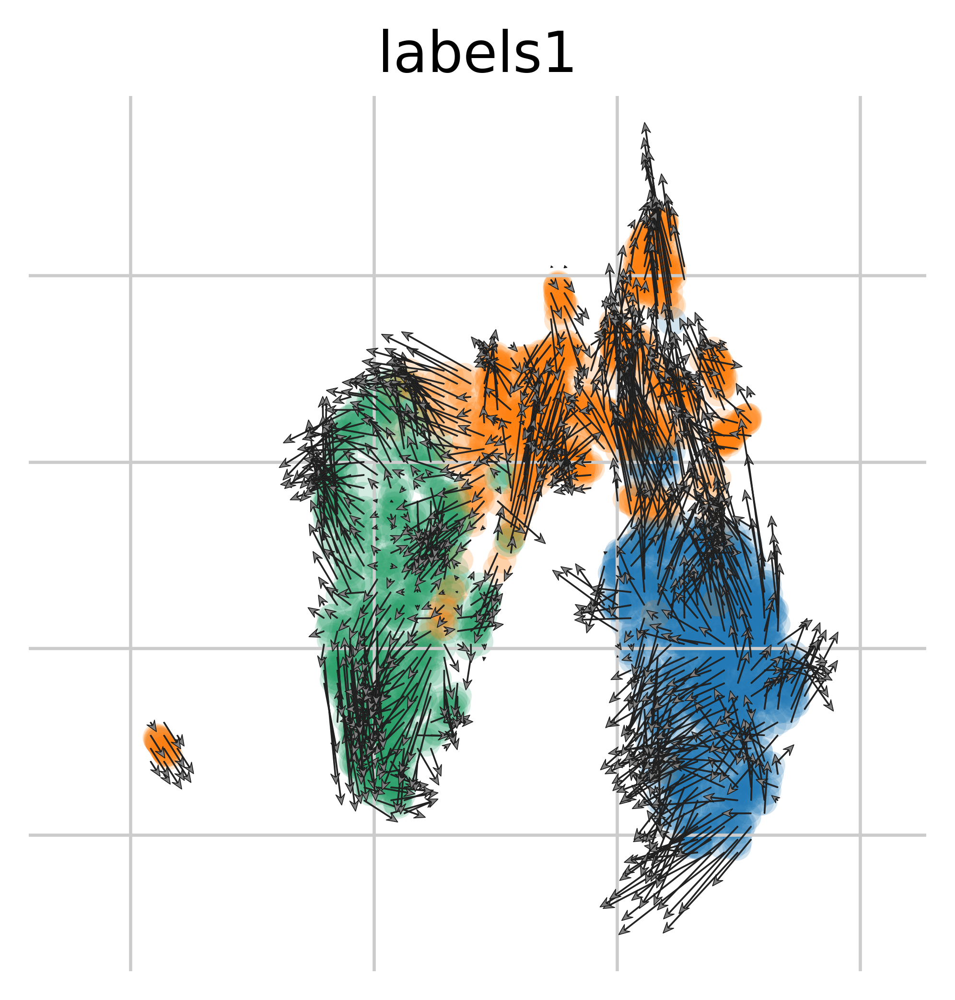

In [100]:
scv.pl.velocity_embedding_grid(contra_Velo_subset, basis='umap', color = 'labels1', dpi = 300, add_margin = 0.2, figsize = (4,4), arrow_length = 16, arrow_size = 2, density = 1)

computing latent time using root_cells as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)


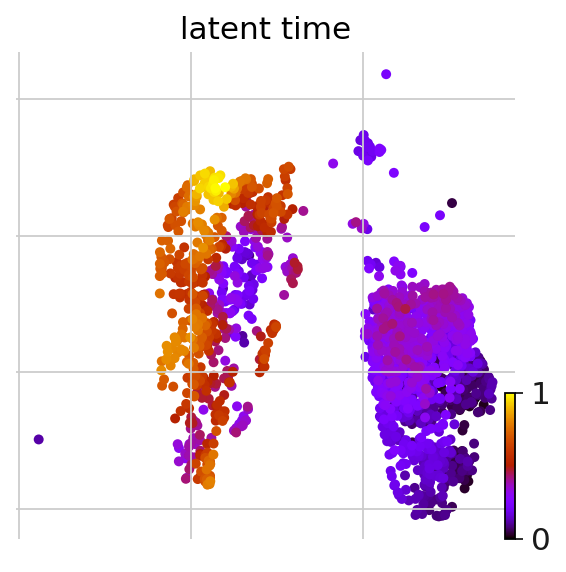

In [101]:
scv.tl.latent_time(intact_Velo_subset)
scv.pl.scatter(intact_Velo_subset, color='latent_time', color_map='gnuplot', size=80)

computing latent time using root_cells as prior
    finished (0:00:03) --> added 
    'latent_time', shared time (adata.obs)


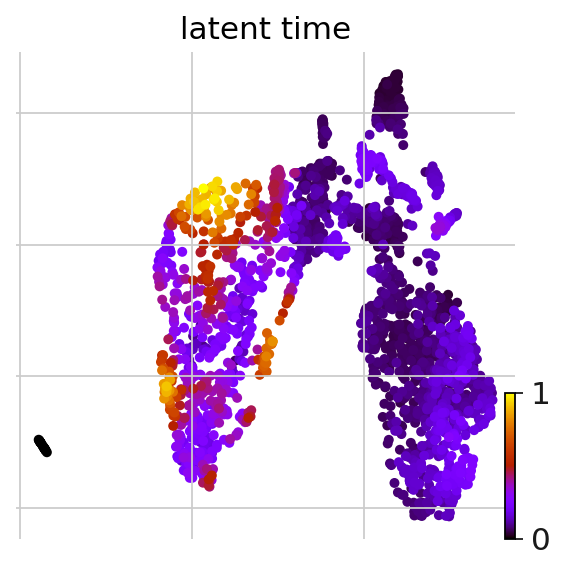

In [102]:
scv.tl.latent_time(contra_Velo_subset)
scv.pl.scatter(contra_Velo_subset, color='latent_time', color_map='gnuplot', size=80)

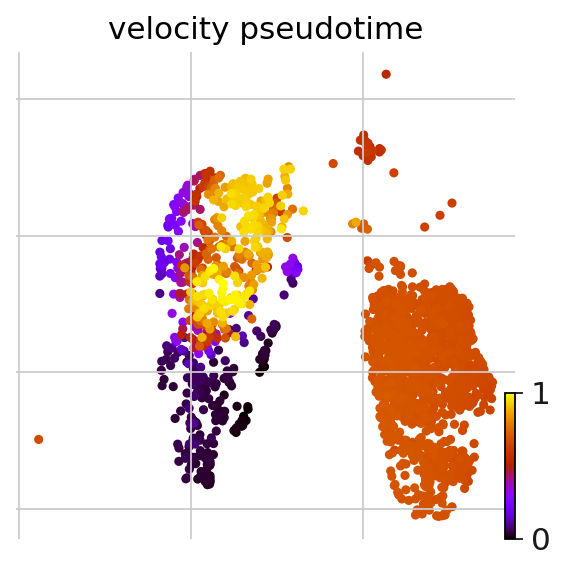

In [103]:
scv.tl.velocity_pseudotime(intact_Velo_subset)
scv.pl.scatter(intact_Velo_subset, color='velocity_pseudotime', cmap='gnuplot')

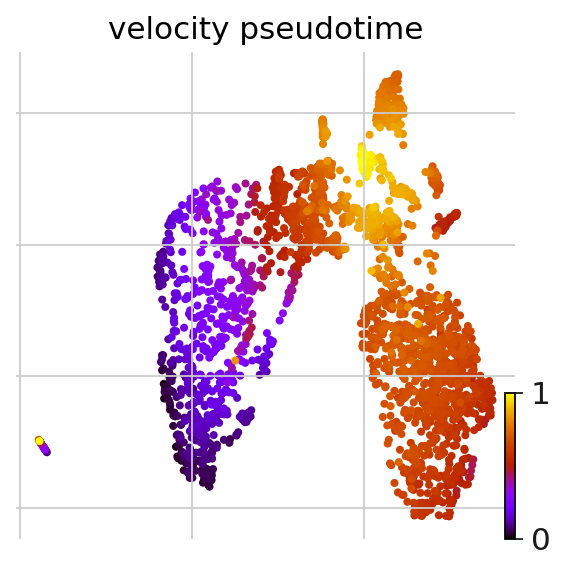

In [104]:
scv.tl.velocity_pseudotime(contra_Velo_subset)
scv.pl.scatter(contra_Velo_subset, color='velocity_pseudotime', cmap='gnuplot')

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)


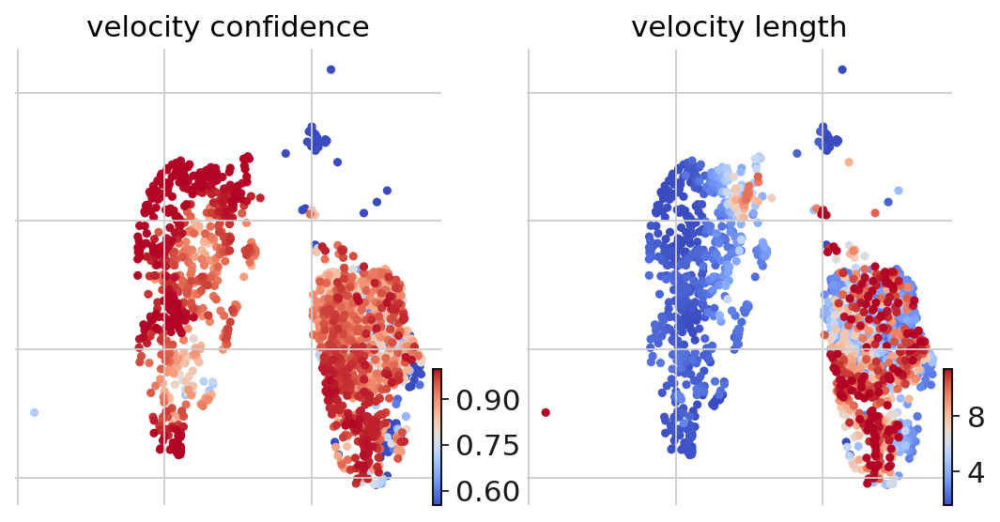

In [105]:
scv.tl.velocity_confidence(intact_Velo_subset)
keys =  'velocity_confidence','velocity_length'
scv.pl.scatter(intact_Velo_subset, c=keys, cmap='coolwarm', perc=[5, 95])

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)


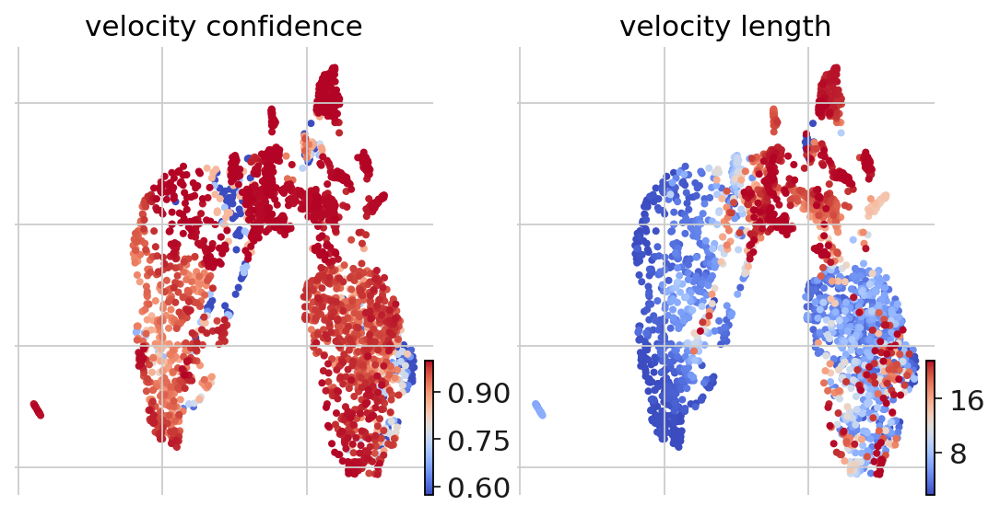

In [106]:
scv.tl.velocity_confidence(contra_Velo_subset)
keys =  'velocity_confidence','velocity_length'
scv.pl.scatter(contra_Velo_subset, c=keys, cmap='coolwarm', perc=[5, 95])

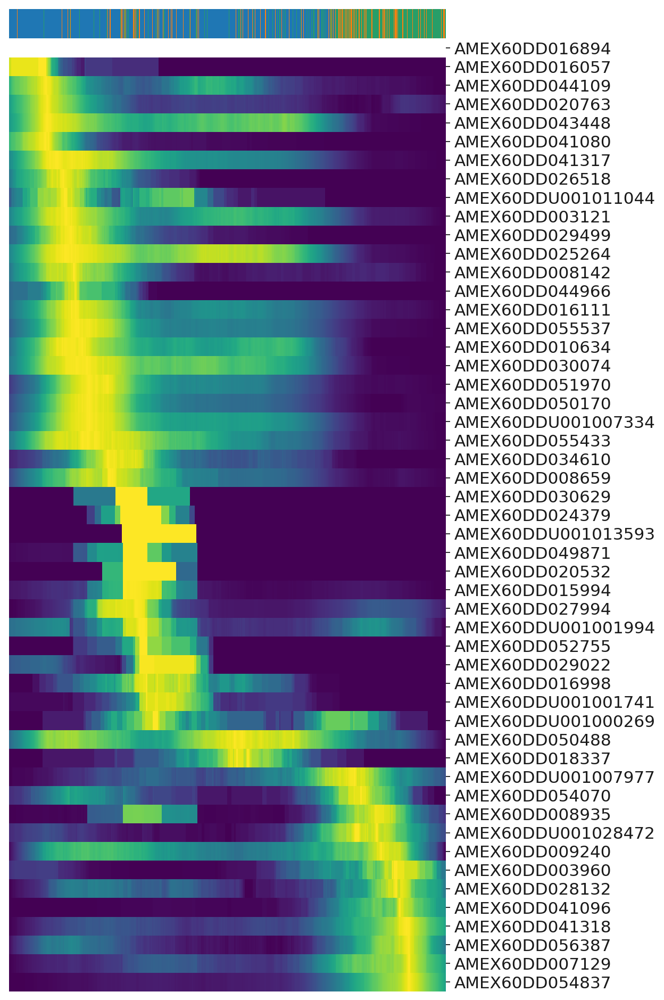

In [136]:
top_genes = intact_Velo_subset.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(intact_Velo_subset, var_names=top_genes, sortby='latent_time', col_color='labels1', n_convolve=300,yticklabels=True, figsize = (8,12))

In [132]:
top_genes

Index(['AMEX60DD016998', 'AMEX60DD025264', 'AMEX60DD041317', 'AMEX60DD051970',
       'AMEX60DDU001028472', 'AMEX60DD003121', 'AMEX60DD055433',
       'AMEX60DD027994', 'AMEX60DD030074', 'AMEX60DDU001001741',
       'AMEX60DD034610', 'AMEX60DD044109', 'AMEX60DDU001000269',
       'AMEX60DDU001001994', 'AMEX60DDU001007334', 'AMEX60DDU001007977',
       'AMEX60DDU001011044', 'AMEX60DDU001013593', 'AMEX60DD003960',
       'AMEX60DD007129', 'AMEX60DD008142', 'AMEX60DD008659', 'AMEX60DD008935',
       'AMEX60DD009240', 'AMEX60DD010634', 'AMEX60DD015994', 'AMEX60DD016057',
       'AMEX60DD016111', 'AMEX60DD016894', 'AMEX60DD018337', 'AMEX60DD020532',
       'AMEX60DD020763', 'AMEX60DD024379', 'AMEX60DD026518', 'AMEX60DD028132',
       'AMEX60DD029022', 'AMEX60DD029499', 'AMEX60DD030629', 'AMEX60DD041080',
       'AMEX60DD041096', 'AMEX60DD041318', 'AMEX60DD043448', 'AMEX60DD044966',
       'AMEX60DD049871', 'AMEX60DD050170', 'AMEX60DD050488', 'AMEX60DD052755',
       'AMEX60DD054070', 'AMEX6

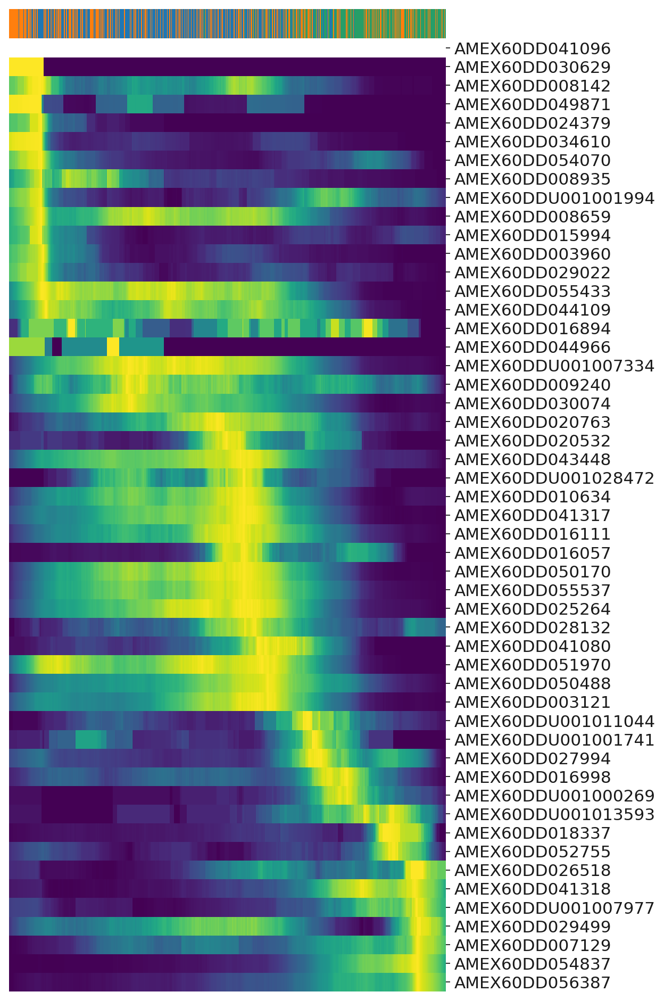

In [137]:
top_genes = contra_Velo_subset.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(contra_Velo_subset, var_names=top_genes, sortby='latent_time', col_color='labels1', n_convolve=300,yticklabels=True, figsize = (8,12))

In [109]:
intact_Velo_subset.uns['neighbors']['distances'] = intact_Velo_subset.obsp['distances']
intact_Velo_subset.uns['neighbors']['connectivities'] = intact_Velo_subset.obsp['connectivities']

scv.tl.paga(intact_Velo_subset, groups='labels1')
df = scv.get_df(intact_Velo_subset, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


,0,1,2
0,0,0,0
1,0.12,0,0
2,0,0.02,0


In [110]:
contra_Velo_subset.uns['neighbors']['distances'] = contra_Velo_subset.obsp['distances']
contra_Velo_subset.uns['neighbors']['connectivities'] = contra_Velo_subset.obsp['connectivities']

scv.tl.paga(contra_Velo_subset, groups='labels1')
df = scv.get_df(contra_Velo_subset, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


,0,1,2
0,0,0,0
1,0,0,0
2,0,0.059,0


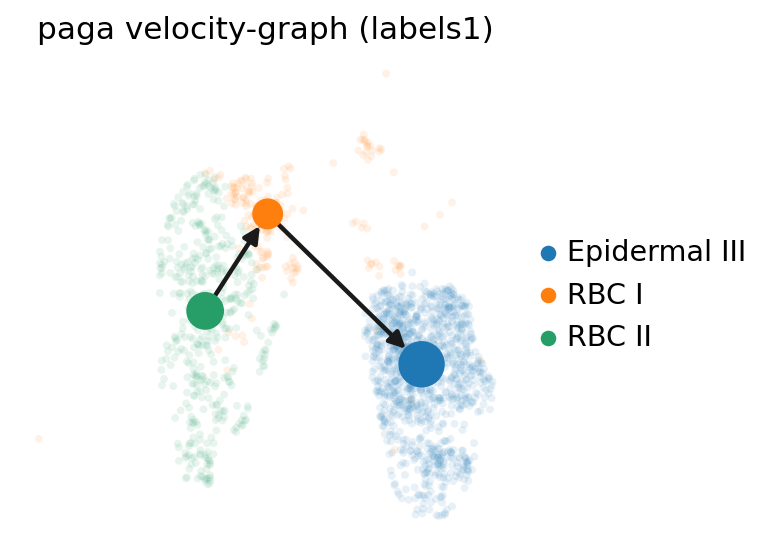

In [111]:
scv.pl.paga(intact_Velo_subset, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5)

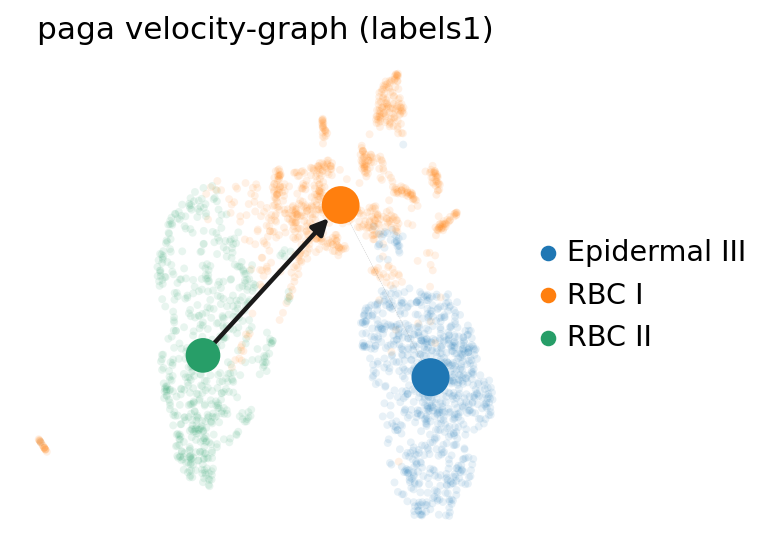

In [118]:
scv.pl.paga(contra_Velo_subset, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5)

In [116]:
contra_Velo_subset.write_h5ad('/mnt/c/Users/Emil/10X/contra.h5ad')

In [117]:
intact_Velo_subset.write_h5ad('/mnt/c/Users/Emil/10X/intact.h5ad')

In [163]:
var_names = ['AMEX60DD041056']
scv.pl.scatter(intact_Velo, var_names, frameon=False)
scv.pl.scatter(intact_Velo, x='latent_time', y=var_names, frameon=False)

TypeError: unhashable type: 'list'

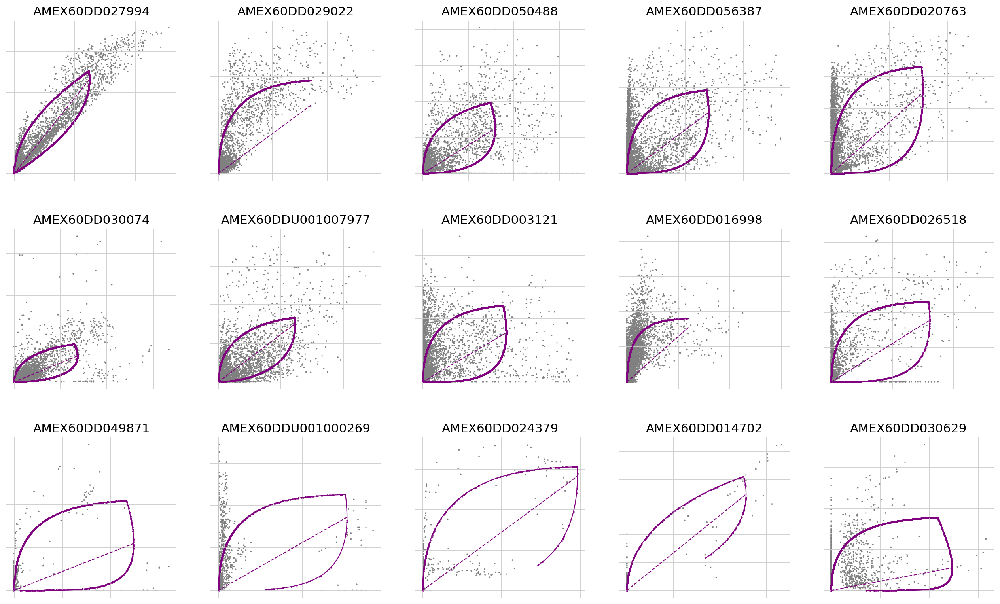

ValueError: x or y do not share the same dimension.

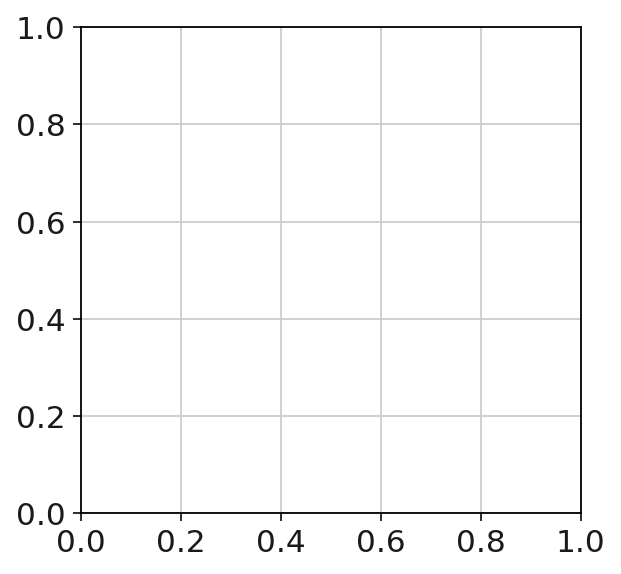

In [146]:
top_genes = intact_Velo.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(intact_Velo, basis=top_genes[:15], ncols=5, frameon=False)
scv.pl.scatter(intact_Velo, x='latent_time', y=top_genes, frameon=False)

In [153]:
intact_Velo

AnnData object with n_obs × n_vars = 10950 × 54
    obs: 'seq_folder', 'nUMI', 'nGene', 'percent.mt', 'log10GenesPerUMI', 'cells', 'sample', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.4', 'nCount_RNA', 'nFeature_RNA', 'RNA_snn_res.0.6', 'RNA_snn_res.0.1', 'RNA_snn_res.1', 'labels1', 'sample_batch', 'Clusters', '_X', '_Y', 'batch', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s'

In [156]:
scv.tl.rank_dynamical_genes(intact_Velo, groupby='labels1')
df = scv.get_df(intact_Velo, 'rank_dynamical_genes/names')
df.head(5)

ranking genes by cluster-specific likelihoods
    finished (0:00:01) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


,Basal epidermis,Endothelial I,Endothelial II,Epidermal I,Epidermal II,Epidermal III,Epidermal IV,Fibroblast I,Fibroblast II,Fibroblast III,...,Fibroblast VI,Fibroblast VII,Fibroblast VIII,Hematopoetic progenitor I,Hematopoetic progenitor II,Myeloid progenitor,RBC I,RBC II,Skeletal muscle,T-cell
0,AMEX60DD010634,AMEX60DD029022,AMEX60DDU001001741,AMEX60DD010634,AMEX60DD020763,AMEX60DD050488,AMEX60DD003960,AMEX60DD027994,AMEX60DD016998,AMEX60DD027994,...,AMEX60DD029022,AMEX60DD016998,AMEX60DD027994,AMEX60DDU001001994,AMEX60DDU001001994,AMEX60DD016894,AMEX60DD027994,AMEX60DD056387,AMEX60DD056387,AMEX60DD015994
1,AMEX60DD034610,AMEX60DD027994,AMEX60DD034610,AMEX60DD056387,AMEX60DD026518,AMEX60DD010634,AMEX60DD026518,AMEX60DD034610,AMEX60DD030629,AMEX60DD030629,...,AMEX60DDU001007977,AMEX60DDU001001741,AMEX60DDU001007977,AMEX60DD034610,AMEX60DD034610,AMEX60DD008935,AMEX60DD034610,AMEX60DD016894,AMEX60DD016894,AMEX60DD014702
2,AMEX60DD044109,AMEX60DDU001000269,AMEX60DD044109,AMEX60DD016894,AMEX60DD056387,AMEX60DD030074,AMEX60DD056387,AMEX60DD044109,AMEX60DD034610,AMEX60DD034610,...,AMEX60DD016998,AMEX60DD034610,AMEX60DD056387,AMEX60DD044109,AMEX60DD044109,AMEX60DD024379,AMEX60DD044109,AMEX60DDU001001741,AMEX60DDU001001741,AMEX60DDU001028472
3,AMEX60DD030074,AMEX60DD016057,AMEX60DD030074,AMEX60DDU001001741,AMEX60DD034610,AMEX60DD034610,AMEX60DD050488,AMEX60DD030074,AMEX60DD044109,AMEX60DD044109,...,AMEX60DD034610,AMEX60DD044109,AMEX60DD044109,AMEX60DD030074,AMEX60DD030074,AMEX60DD054070,AMEX60DD030074,AMEX60DDU001001994,AMEX60DDU001001994,AMEX60DDU001000269
4,AMEX60DD044966,AMEX60DDU001001741,AMEX60DD044966,AMEX60DDU001001994,AMEX60DD044109,AMEX60DD044109,AMEX60DD020763,AMEX60DD044966,AMEX60DD030074,AMEX60DDU001007977,...,AMEX60DD044109,AMEX60DD030074,AMEX60DD034610,AMEX60DD044966,AMEX60DD044966,AMEX60DD049871,AMEX60DD044966,AMEX60DDU001007977,AMEX60DDU001007977,AMEX60DD016894


In [179]:
scv.tl.rank_dynamical_genes(contra_Velo, groupby='labels1')
df = scv.get_df(contra_Velo, 'rank_dynamical_genes/names')
df.head(5)

ranking genes by cluster-specific likelihoods
    finished (0:00:05) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


,Basal epidermis,Endothelial I,Endothelial II,Epidermal I,Epidermal II,Epidermal III,Epidermal IV,Fibroblast I,Fibroblast II,Fibroblast III,...,Fibroblast VI,Fibroblast VII,Fibroblast VIII,Hematopoetic progenitor I,Hematopoetic progenitor II,Myeloid progenitor,RBC I,RBC II,Skeletal muscle,T-cell
0,AMEX60DD034610,AMEX60DD039125,AMEX60DDU001000269,AMEX60DD041317,AMEX60DD020763,AMEX60DD025264,AMEX60DD003960,AMEX60DD027994,AMEX60DD016998,AMEX60DD027994,...,AMEX60DD029022,AMEX60DD029022,AMEX60DD027994,AMEX60DD016894,AMEX60DDU001038083,AMEX60DD010597,AMEX60DD050488,AMEX60DD054837,AMEX60DDU001025750,AMEX60DD044966
1,AMEX60DD008659,AMEX60DDU001000269,AMEX60DDU001001741,AMEX60DD055433,AMEX60DD044109,AMEX60DD055537,AMEX60DD055537,AMEX60DD009240,AMEX60DD052755,AMEX60DD028378,...,AMEX60DD016998,AMEX60DD052755,AMEX60DD003121,AMEX60DD004428,AMEX60DDU001028472,AMEX60DD015994,AMEX60DD056387,AMEX60DD009240,AMEX60DD009240,AMEX60DDU001041425
2,AMEX60DD009240,AMEX60DD009240,AMEX60DD009240,AMEX60DD008659,AMEX60DD026518,AMEX60DD050488,AMEX60DD020763,AMEX60DD055433,AMEX60DD029499,AMEX60DD009240,...,AMEX60DD009240,AMEX60DD009240,AMEX60DD008142,AMEX60DD052755,AMEX60DDU001001994,AMEX60DD010506,AMEX60DD055537,AMEX60DD055433,AMEX60DD055433,AMEX60DD015994
3,AMEX60DD055433,AMEX60DD055433,AMEX60DD055433,AMEX60DDU001013593,AMEX60DD016057,AMEX60DD010634,AMEX60DD056387,AMEX60DD008659,AMEX60DD009240,AMEX60DD055433,...,AMEX60DD052755,AMEX60DDU001001741,AMEX60DD016998,AMEX60DDU001001994,AMEX60DD043448,AMEX60DD015880,AMEX60DD003121,AMEX60DD008659,AMEX60DD008659,AMEX60DD016894
4,AMEX60DDU001013593,AMEX60DD008659,AMEX60DD008659,AMEX60DD009240,AMEX60DD056387,AMEX60DD055433,AMEX60DD026518,AMEX60DDU001013593,AMEX60DD055433,AMEX60DD008659,...,AMEX60DD055433,AMEX60DD055433,AMEX60DDU001007977,AMEX60DD009240,AMEX60DDU001013593,AMEX60DD054070,AMEX60DD029499,AMEX60DDU001013593,AMEX60DDU001013593,AMEX60DDU001028472


In [157]:
df.head

<bound method NDFrame.head of        Basal epidermis       Endothelial I      Endothelial II  \
0       AMEX60DD010634      AMEX60DD029022  AMEX60DDU001001741   
1       AMEX60DD034610      AMEX60DD027994      AMEX60DD034610   
2       AMEX60DD044109  AMEX60DDU001000269      AMEX60DD044109   
3       AMEX60DD030074      AMEX60DD016057      AMEX60DD030074   
4       AMEX60DD044966  AMEX60DDU001001741      AMEX60DD044966   
5   AMEX60DDU001001741  AMEX60DDU001001994      AMEX60DD010634   
6   AMEX60DDU001000269  AMEX60DDU001007977  AMEX60DDU001000269   
7       AMEX60DD016998  AMEX60DDU001011044      AMEX60DD016998   
8       AMEX60DD030629  AMEX60DDU001028472      AMEX60DD030629   
9   AMEX60DDU001007977      AMEX60DD003121  AMEX60DDU001007977   
10  AMEX60DDU001001994      AMEX60DD003960  AMEX60DDU001001994   
11      AMEX60DD049871      AMEX60DD008935      AMEX60DD056387   
12      AMEX60DD050488      AMEX60DD010634      AMEX60DD003121   
13  AMEX60DDU001011044      AMEX60DD014702    

In [167]:
var_names = ['AMEX60DD003121','AMEX60DD007129']
scv.tl.differential_kinetic_test(intact_Velo, var_names=var_names, groupby='labels1')

recovering dynamics (using 1/12 cores)
    finished (0:00:01) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)

outputs model fit of gene: AMEX60DD007129
testing for differential kinetics
    finished (0:00:02) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pvals_kinetics', p-values of differential kinetics (adata.var)

outputs model fit of gene: AMEX60DD007129


In [162]:
intact_Velo.var

,vst.mean,vst.variance,vst.variance.expected,vst.variance.standardized,vst.variable,Accession,Chromosome,End,Start,Strand,...,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,fit_r2
AMEX60DDU001000269,4.05e-02,1.29e-01,5.51e-02,2.34,1,AMEX60DDU001000269,C0003033,19868,15136,+,...,0.26,3.06e-04,0.0,0.0,4.76e-01,0.16,1.65,2.49,1.26,2.11e-02
AMEX60DDU001001741,2.19e-01,9.45e-01,4.30e-01,2.20,1,AMEX60DDU001001741,C0010106,132843,29046,-,...,0.15,3.53e-06,0.0,0.0,4.93e-01,1.12,0.87,1.34,0.86,1.53e-01
AMEX60DDU001001994,2.44e-01,2.42e+00,4.95e-01,4.90,1,AMEX60DDU001001994,C0011228,45640,3375,+,...,2.86,4.79e-09,0.0,0.0,4.98e-01,0.83,14.78,0.82,1.07,5.38e-01
AMEX60DDU001007334,1.71e+00,3.49e+01,9.38e+00,3.71,1,AMEX60DDU001007334,C0045198,41874,2033,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.96e-01
AMEX60DDU001007977,4.32e-01,2.44e+00,1.05e+00,2.32,1,AMEX60DDU001007977,C0053310,182624,2136,-,...,0.18,1.36e-01,0.0,0.0,4.79e-01,0.87,0.49,1.29,1.94,2.47e-01
AMEX60DDU001011044,9.09e-02,1.38e+00,1.48e-01,7.81,1,AMEX60DDU001011044,C0102752,35424,1536,-,...,0.09,6.24e-13,0.0,0.0,2.39e-01,0.17,0.21,0.63,1.27,1.46e-01
AMEX60DDU001013593,1.26e-01,5.53e-01,2.19e-01,2.52,1,AMEX60DDU001013593,C0114401,14797,1001,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-7.62e-02
AMEX60DDU001028472,7.02e-02,3.84e-01,1.08e-01,3.55,1,AMEX60DDU001028472,C0167494,2841,95,-,...,0.04,3.62e-09,0.0,0.0,4.66e-01,0.21,0.27,0.60,2.93,1.12e-01
AMEX60DDU001033596,5.83e-03,3.39e-02,6.31e-03,3.47,1,AMEX60DDU001033596,C0185689,3877,527,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.32e-01
AMEX60DD003121,2.08e+00,7.05e+01,1.34e+01,5.25,1,AMEX60DD003121,10q,62476074,62385303,+,...,6.15,1.34e-01,0.0,0.0,4.99e-01,0.41,21.12,1.20,1.01,5.23e-02


In [168]:
scv.get_df(intact_Velo[:, var_names], ['fit_diff_kinetics', 'fit_pval_kinetics'], precision=2)

IndexError: index 0 is out of bounds for axis 0 with size 0

In [169]:
top_genes = intact_Velo.var['fit_likelihood'].sort_values(ascending=False).index[:100]
scv.tl.differential_kinetic_test(intact_Velo, var_names=top_genes, groupby='labels1')

recovering dynamics (using 1/12 cores)


  0%|          | 0/24 [00:00<?, ?gene/s]

    finished (0:00:27) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
testing for differential kinetics
    finished (0:00:59) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pvals_kinetics', p-values of differential kinetics (adata.var)


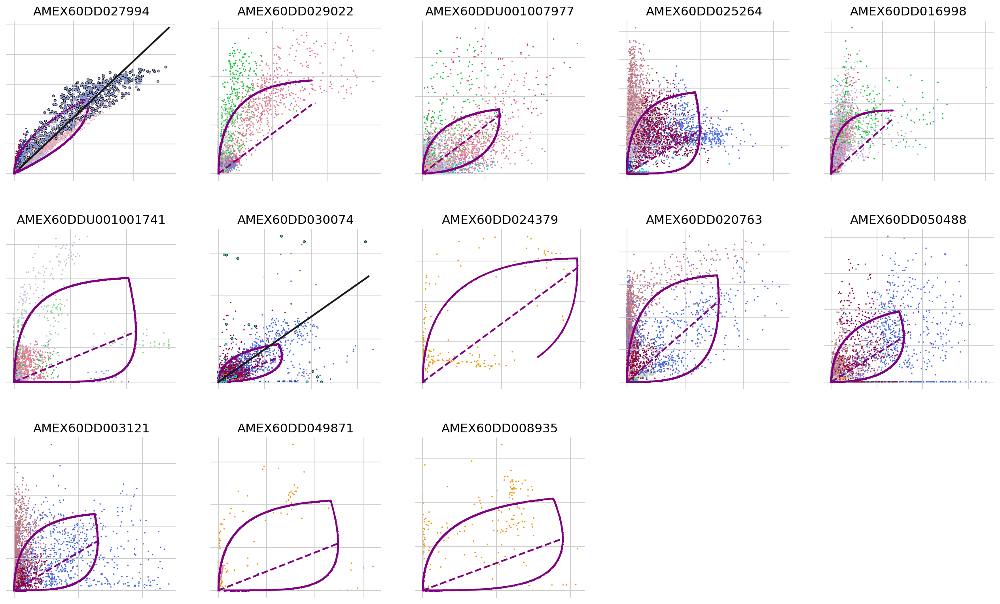

In [176]:
scv.pl.scatter(intact_Velo, basis=top_genes[:15], ncols=5, add_outline='fit_diff_kinetics',**kwargs)

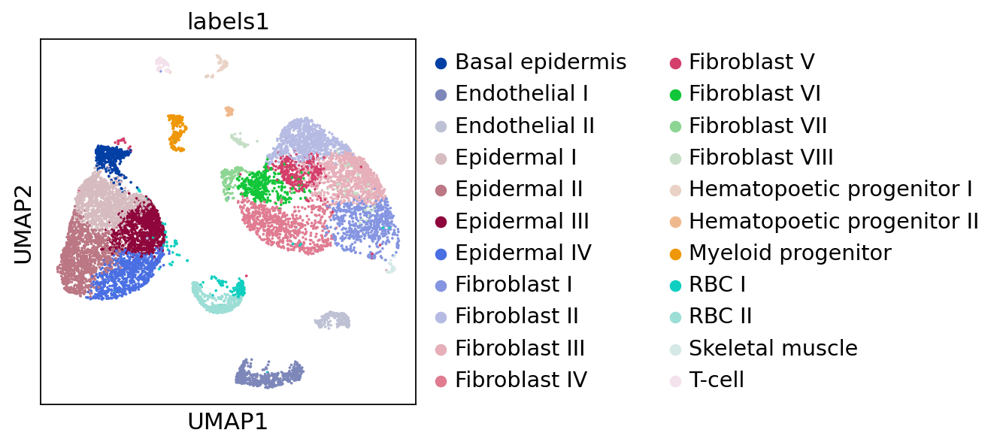

In [172]:
sc.pl.umap(intact_Velo,color=['labels1'])

In [173]:
top_genes = contra_Velo.var['fit_likelihood'].sort_values(ascending=False).index[:100]
scv.tl.differential_kinetic_test(contra_Velo, var_names=top_genes, groupby='labels1')

recovering dynamics (using 1/12 cores)


  0%|          | 0/20 [00:00<?, ?gene/s]

    finished (0:00:43) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
testing for differential kinetics
    finished (0:02:16) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pvals_kinetics', p-values of differential kinetics (adata.var)


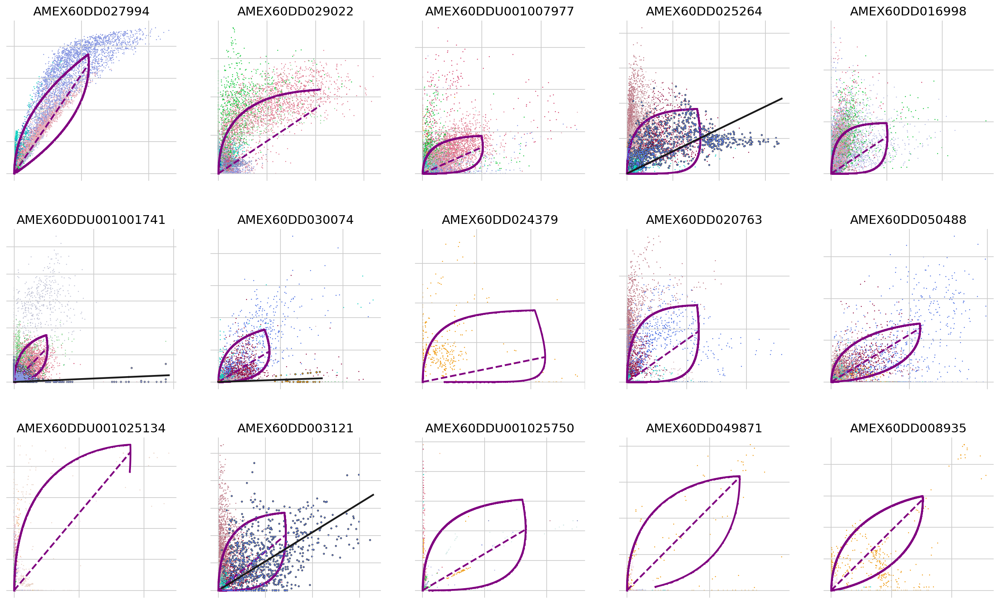

In [178]:
scv.pl.scatter(contra_Velo, basis=top_genes[:15], ncols=5, add_outline='fit_diff_kinetics', **kwargs)

In [175]:
kwargs = dict(linewidth=2, add_linfit=True, frameon=False)

In [180]:
pip install git+https://github.com/mossjacob/pcurvepy

  Cloning https://github.com/mossjacob/pcurvepy to /tmp/pip-req-build-n0_6a566
  Running command git clone --filter=blob:none --quiet https://github.com/mossjacob/pcurvepy /tmp/pip-req-build-n0_6a566
  Resolved https://github.com/mossjacob/pcurvepy to commit 620fb94272e653310ff9f464dc2cd00ea8d568b5
  Preparing metadata (setup.py) ... done
  Created wheel for pcurvepy: filename=pcurvepy-1.0-py3-none-any.whl size=17017 sha256=6b9a958b6d30baddacc47c8d4aa8b62cb9eacb3fb83423b1243cebab45d5ae71
  Stored in directory: /tmp/pip-ephem-wheel-cache-2unm6y9s/wheels/e1/59/d5/48cbebe279c042c18cf9d05ddd01d2cf32ac40ce275b08bf26
Successfully built pcurvepy

[notice] A new release of pip available: 22.3.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [181]:
pip install pyslingshot


[notice] A new release of pip available: 22.3.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [183]:
pip install torch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.5/887.5 MB 1.9 MB/s eta 0:00:0000:0100:07
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.0/21.0 MB 3.9 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.1/317.1 MB 2.5 MB/s eta 0:00:0000:0100:03
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 849.3/849.3 kB 4.5 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 557.1/557.1 MB 1.8 MB/s eta 0:00:0000:0100:04

[notice] A new release of pip available: 22.3.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [182]:
import torch
import numpy as np

from matplotlib import pyplot as plt

from slingshot import Slingshot

ModuleNotFoundError: No module named 'torch'